In [1]:
import torch
print("CUDA Available: ", torch.cuda.is_available())
print("Number of GPUs: ", torch.cuda.device_count())

CUDA Available:  True
Number of GPUs:  1


In [2]:
import sys
import os
import anndata
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns

In [3]:
import torch
import torch.distributed as dist
from torch.nn.parallel import DistributedDataParallel as DDP

In [4]:
adata = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/data_for_run/adata_norm.h5ad')

In [5]:
adata.obs['group'].unique()

['Rad', 'Rad&Drug', 'Control']
Categories (3, object): ['Control', 'Rad', 'Rad&Drug']

In [6]:
adata.obs['group_new'] = adata.obs['group'].map({'Rad':'Control', 'Rad&Drug':'Rad','Control':'Rad&Drug'})

In [7]:
adata = adata[adata.obs['Major_type']!='HSC-like']

In [8]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=50)
sc.tl.umap(adata,min_dist=0.8)

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:314: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm["X_pca"] = X_pca


EC1
EC2
EC3
EC4
EC5
EC6
Fibroblast1
Fibroblast2
Fibroblast3
Fibroblast4
Fibroblast5
Fibroblast6
Fibroblast7
Mural1
Mural2
Mural3
Mural4
Mural5
Mural6
Mural7
Mural8
Mural9


(-9.94258975982666, 19.812451362609863, -3.523040544986725, 16.751317512989043)

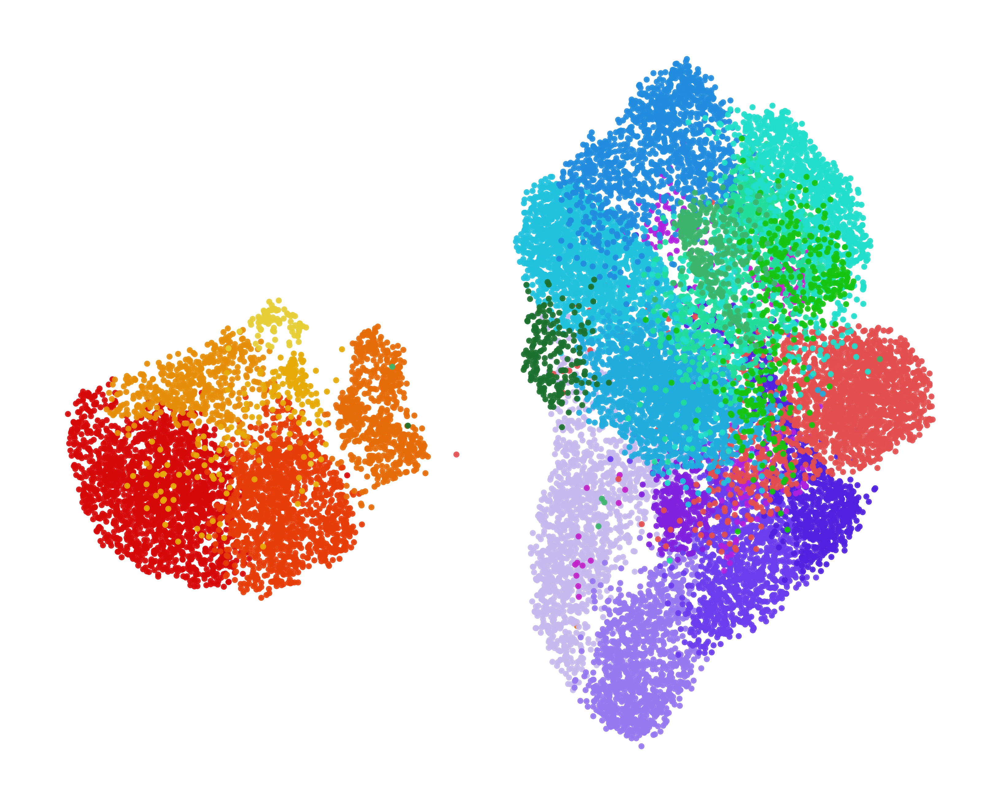

In [9]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors  = ['#d60909', # EC1
               '#e63d09', # EC2
               '#e66c09', # EC3
               '#e68e09', # EC4
               '#e6ab09', # EC5
               '#e6ce37', # EC6
               '#c6b9ed', # Fibroblast1, 
               '#9678f0', # Fibroblast2, 
               '#6a3eed', # Fibroblast3, 
               '#5021de', # Fibroblast4,
               '#8021de', # Fibroblast5, 
               '#af21de', # Fibroblast6, 
               '#c122c9', # Fibroblast7, 
               '#e34f4f', # HSC
               '#21c2de', # Mural1 
               '#21acde', # Mural2
               '#218cde', # Mural3
               '#21de9c', # Mural4
               '#21decb', # Mural5
               '#16c410', # Mural6 
               '#3cb56c', # Mural7
               '#1c702d', # Mural8
               '#63d690' # Mural9 
              ]
# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(5,4),dpi=800)
for (j,i) in enumerate(np.unique(adata.obs['Minor_type'])):
    print(i)
    g=axs.scatter(adata.obsm['X_umap'][adata.obs['Minor_type']==i, 0], 
                  adata.obsm['X_umap'][adata.obs['Minor_type']==i, 1], 
                  color=hex_colors[j], 
                  alpha=0.9,s=0.6, 
                 )
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

(-9.94258975982666, 19.812451362609863, -3.523040544986725, 16.751317512989043)

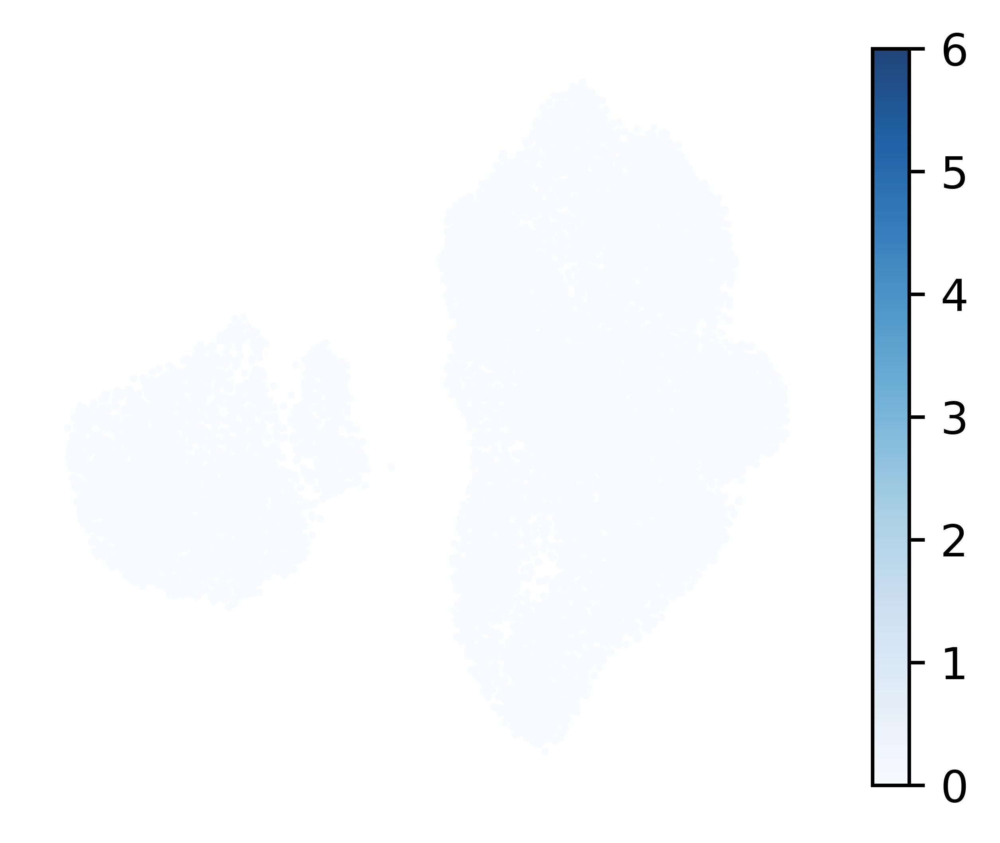

In [10]:
fig, axs = plt.subplots(1,1,figsize=(4,3),dpi=800)
g = axs.scatter(adata.obsm['X_umap'][:, 0], 
            adata.obsm['X_umap'][:, 1], 
            c=adata[:,'PTPRC'].to_df().values, 
            alpha=0.9,s=0.5, 
            cmap = 'Blues',
            vmin=0,
            vmax=6
         )
plt.colorbar(g)
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/scanpy/plotting/_tools/paga.py:965: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(


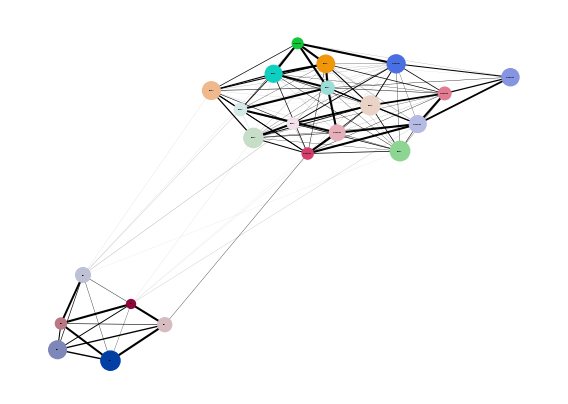

(-1.05, 22.05, 0.945, 1.0550000000000002)

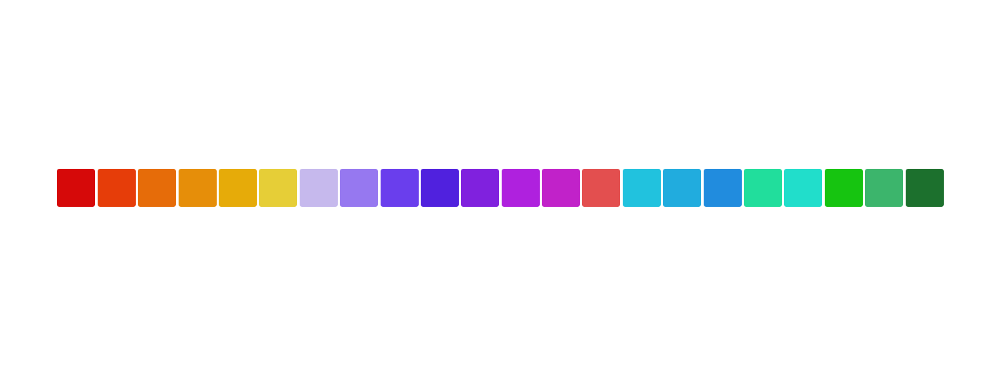

In [11]:
sc.tl.paga(adata, groups="Minor_type")
#sc.tl.draw_graph(adata_ctl)
sc.pl.paga(adata, 
           color=["Minor_type"],
           edge_width_scale=0.2, 
           frameon = False, 
           fontsize = 0,
           cmap = rgb_colors
)
fig = plt.subplots(figsize =(3.6, 1.2),dpi=500)
for i in range(22):    
    plt.scatter(i,1,c=hex_colors[i],marker='s',s=50)
plt.axis('off')

In [12]:
#sc.pp.highly_variable_genes(adata, n_top_genes=500)
#BMP_signaling = ["AHSG","BAMBI","BMP2","BMP4","BMP6","BMP7","BMPR1A","BMPR1B","BMPR2","CER1","CHRD","CHRDL1","CTDSP1","CTDSP2","CTDSPL","FST","GREM1","GSK3B","HJV","MAP3K7","MAPK1","NOG","NUP214","PPM1A","PPP1CA","PPP1R15A","RGMA","RGMB","SKI","SMAD1","SMAD4","SMAD5","SMAD6","SMAD7","SMAD9","SMURF1","SMURF2","SOSTDC1","TAB1","TAB2","XIAP","ZFYVE16"]
others  = ['NANOG','T','GATA6','POU5F1','HAND1','MKI67',
           'ETV2','CLDN5','PECAM1','SOX17','COL4A1','DCN',
           'ACTA2','PDGFRB','FOXA2','EOMES','MIXL1','COL5A1',
           'CXCR4','NR2F2','GJA4','PGF','RGS16','ADAMTS18'
          ]
adata.var.highly_variable  = False
others = list(sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/results/fig4/interp_all_ann.h5ad').var_names)



for i in others:
    adata.var.highly_variable[i]=True
    
gcsf_associated_genes = [
    "CSF3",   # Colony Stimulating Factor 3
    "CSF3R",  # Colony Stimulating Factor 3 Receptor
    "JAK2",   # Janus Kinase 2
    "STAT3",  # Signal Transducer and Activator of Transcription 3
    "STAT5A", # Signal Transducer and Activator of Transcription 5A
    "STAT5B", # Signal Transducer and Activator of Transcription 5B
    "PIK3CA", # Phosphatidylinositol-4,5-Bisphosphate 3-Kinase Catalytic Subunit Alpha
    "AKT1",   # AKT Serine/Threonine Kinase 1
    "MAPK1",  # Mitogen-Activated Protein Kinase 1 (ERK2)
    "MAPK3",  # Mitogen-Activated Protein Kinase 3 (ERK1)
    "BCL2",   # BCL2 Apoptosis Regulator
    "BAX",    # BCL2 Associated X, Apoptosis Regulator
    "CXCR2",  # C-X-C Motif Chemokine Receptor 2
    "ELANE",  # Elastase, Neutrophil Expressed
    "MMP9",   # Matrix Metallopeptidase 9
    "ITGB2",  # Integrin Subunit Beta 2
    "CD33",   # Cluster of Differentiation 33
    "CEBPA",  # CCAAT/Enhancer Binding Protein Alpha
    "MYC"     # MYC Proto-Oncogene, BHLH Transcription Factor
]
for i in gcsf_associated_genes:
    adata.var.highly_variable[i]=True


/tmp/ipykernel_780930/3202456027.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable[i]=True
/tmp/ipykernel_780930/3202456027.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

In [13]:
'ERK' in adata.var_names

False

In [13]:
adata = adata[:, adata.var.highly_variable]

In [14]:
adata

View of AnnData object with n_obs × n_vars = 18989 × 612
    obs: 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'umap_X', 'umap_Y', 'PhenoGraph_clusters', 'Major_type', 'Minor_type', 'group_new'
    var: 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'paga', 'Minor_type_sizes', 'Minor_type_colors'
    obsm: 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

## subsampling to normal VO first

In [15]:
temp_ = adata.obs[['group_new','Major_type']]
del adata.var
del adata.obsm
del adata.obs
adata.obs = temp_
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=50)
sc.tl.umap(adata,min_dist=0.5)
adata.obs['group_major_type'] = [i+'_'+j for (i,j) in zip(adata.obs['group_new'],adata.obs['Major_type'])]

In [16]:
np.unique(adata.obs['group_major_type'])

array(['Control_EC', 'Control_Fibroblast', 'Control_Mural', 'Rad&Drug_EC',
       'Rad&Drug_Fibroblast', 'Rad&Drug_Mural', 'Rad_EC',
       'Rad_Fibroblast', 'Rad_Mural'], dtype=object)

Control_EC
Control_Fibroblast
Control_Mural
Rad&Drug_EC
Rad&Drug_Fibroblast
Rad&Drug_Mural
Rad_EC
Rad_Fibroblast
Rad_Mural


(-5.1865651369094845,
 16.399445748329164,
 -3.8187323689460753,
 12.623147833347321)

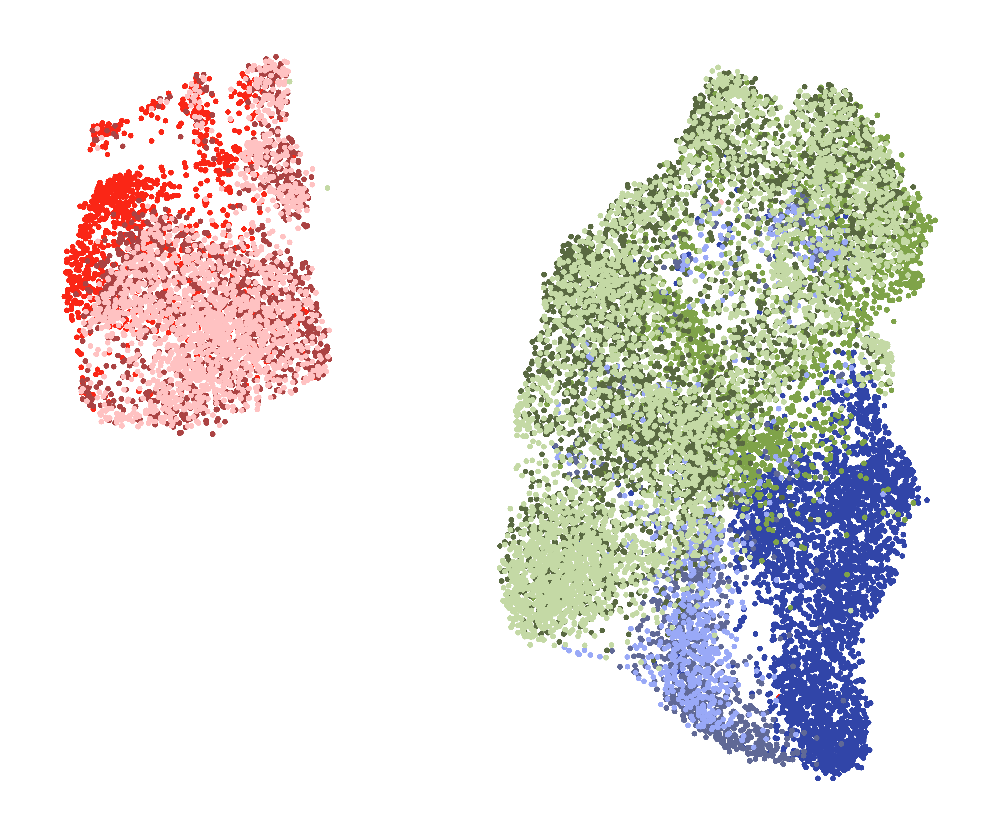

In [17]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors = [ '#fa2616','#3145a8','#7fa349', 
              '#ab4343','#606996','#596941',
              '#ffc2c2','#99a9f7','#c4d9a5',]

# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(6,5),dpi=800)
for i in np.unique(adata.obs['group_major_type']):
    print(i)
    g=axs.scatter(adata.obsm['X_umap'][adata.obs['group_major_type']==i, 0], 
                  adata.obsm['X_umap'][adata.obs['group_major_type']==i, 1], 
                  color=rgb_colors[list(np.unique(adata.obs['group_major_type'])).index(i)], 
                  alpha=1,s=1, 
                  label='Reconstructed')
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

In [18]:
adata.obs['train']= '-1'
adata.obs['train'][adata.obs['Major_type']=='EC']= '1'

/tmp/ipykernel_780930/3396674746.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs['train'][adata.obs['Major_type']=='EC']= '1'
/tmp/ipykernel_780930/3396674746.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy

In [19]:
adata

AnnData object with n_obs × n_vars = 18989 × 612
    obs: 'group_new', 'Major_type', 'group_major_type', 'train'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'paga', 'Minor_type_sizes', 'Minor_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [20]:
adata.obs['train'][(adata.obs['Major_type']!='EC') & (adata.obs['group_new']=='Control')]= '0'

/tmp/ipykernel_780930/2395942887.py:1: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs['train'][(adata.obs['Major_type']!='EC') & (adata.obs['group_new']=='Control')]= '0'
/tmp/ipykernel_780930/2395942887.py:1: SettingWithCopyWarning

-1
0
1


(-5.1865651369094845,
 16.399445748329164,
 -3.8187323689460753,
 12.623147833347321)

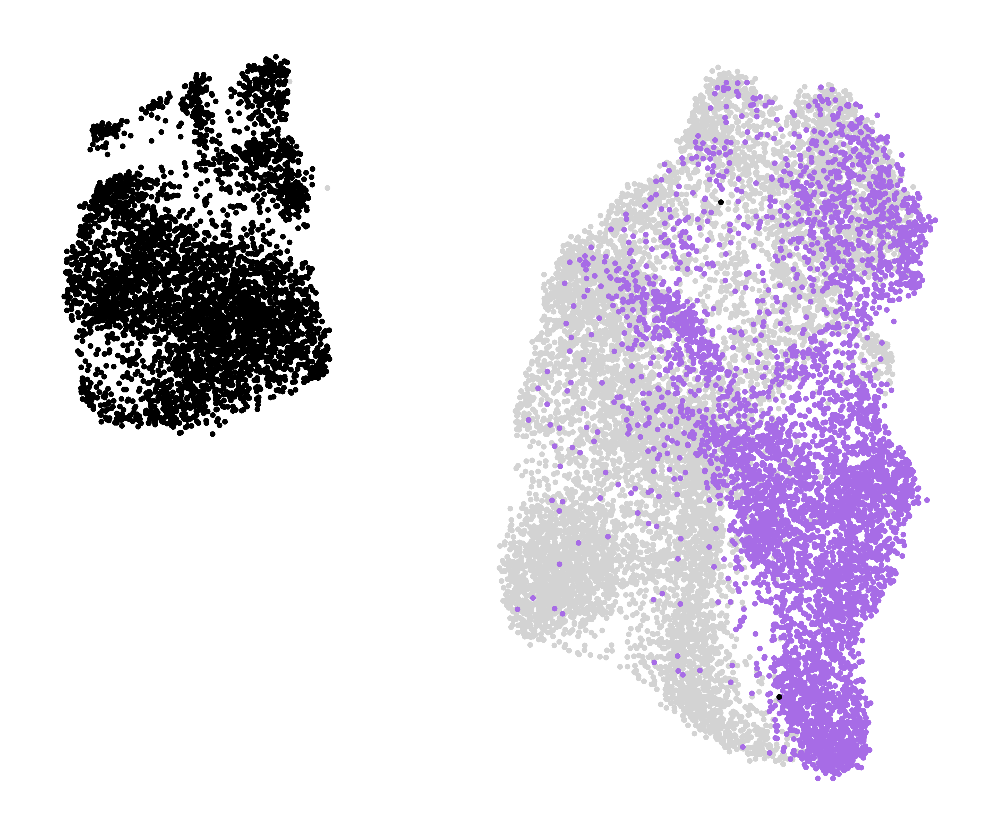

In [21]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors = [ 'lightgray','#a76ce6','k']

# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(6,5),dpi=800)
for i in np.unique(adata.obs['train']):
    print(i)
    g=axs.scatter(adata.obsm['X_umap'][adata.obs['train']==i, 0], 
                  adata.obsm['X_umap'][adata.obs['train']==i, 1], 
                  color=rgb_colors[list(np.unique(adata.obs['train'])).index(i)], 
                  alpha=1,s=1, 
                  label='Reconstructed')
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

## if I only trained control and EC with rad, explore how it look like

In [22]:
trained_adata = adata[
    (adata.obs['Major_type']=='EC')# |
   # ((adata_ctl_rad.obs['Major_type']!='EC')&(adata_ctl_rad.obs['group']=='Control'))
].copy()

In [23]:
np.unique([i+'_'+j for (i,j) in zip(trained_adata.obs['Major_type'],trained_adata.obs['group_new'])]
         )

array(['EC_Control', 'EC_Rad', 'EC_Rad&Drug'], dtype='<U11')

In [29]:
trained_adata.obs['Major_type'].unique()

['EC']
Categories (1, object): ['EC']

In [30]:
trained_adata.obs['group_new'] = trained_adata.obs['group_new'].map({'Control':0,
                                                                     'Rad':1,
                                                                     'Rad&Drug':2
                             })

trained_adata.obs['Major_type'] = trained_adata.obs['Major_type'].map({'EC':1,
                                                                       'Fibroblast':2,
                                                                       'Mural':3,
                             })
trained_adata.obs['Major_type']  = trained_adata.obs['Major_type'].astype(int).astype('category')
trained_adata.obs['group_new']  = trained_adata.obs['group_new'].astype(int).astype('category')


In [31]:
del trained_adata.obs['group_major_type']

In [32]:
del trained_adata.obs['train']

In [34]:
trained_adata.write('/hpc/mydata/siyu.he/squidward_study/data_for_run/VO_rad_drug_trained_adata.h5ad')


In [35]:
trained_adata

AnnData object with n_obs × n_vars = 4403 × 612
    obs: 'group_new', 'Major_type'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [37]:
import matplotlib
from matplotlib import rcParams
import sys
import os

import pandas as pd
import scanpy as sc
import numpy as np
import warnings

import torch
import torch.nn.functional as F
import torch.nn as nn

from torch.utils.data import DataLoader, TensorDataset

import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns
import matplotlib.font_manager
from matplotlib import rcParams

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'
rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 300})
rcParams.update({'figure.figsize': (3,3)})
rcParams.update({'savefig.dpi': 500})
warnings.filterwarnings('ignore')

%load_ext autoreload
%autoreload 2

import io
import os
import socket

import torch as th
import torch.distributed as dist
import argparse

from Squidiff import dist_util,logger

from Squidiff.scrna_datasets import load_VO_rad_drug_data,prepared_data
from Squidiff.resample import create_named_schedule_sampler
from Squidiff.script_util import (
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    args_to_dict,
    add_dict_to_argparser,
)

from Squidiff.train_util import TrainLoop

GPUS_PER_NODE = 1 

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [38]:

def get_default_args():
    defaults = dict(
        data_dir="",
        schedule_sampler="uniform",
        lr=1e-4,
        weight_decay=0.0,
        lr_anneal_steps=0,
        batch_size=64,
        microbatch=-1,  # -1 disables microbatches
        ema_rate="0.9999",  # comma-separated list of EMA values
        log_interval=5000,
        save_interval=10000,
        resume_checkpoint="",
        use_fp16=False,
        fp16_scale_growth=1e-3,
        use_encoder=False
    )
    defaults.update(model_and_diffusion_defaults())
    return defaults



def setup_dist():
    """
    Setup a distributed process group.
    """
    if dist.is_initialized():
        return
    backend = "gloo" if not th.cuda.is_available() else "nccl"
    dist.init_process_group(backend=backend, init_method="env://")


def dev():
    """
    Get the device to use for torch.distributed.
    """
    if th.cuda.is_available():
        return th.device(f"cuda")
    return th.device("cpu")


def load_state_dict(path, **kwargs):
    """
    Load a PyTorch file without redundant fetches across ranks.
    """
    chunk_size = 2 ** 30  # Size limit for data chunks
    if dist.get_rank() == 0:
        with open(path, "rb") as f:
            data = f.read()
        num_chunks = len(data) // chunk_size
        if len(data) % chunk_size:
            num_chunks += 1
        dist.broadcast(th.tensor(num_chunks), 0)
        for i in range(0, len(data), chunk_size):
            dist.broadcast(th.tensor(data[i: i + chunk_size]), 0)
    else:
        num_chunks = dist.broadcast(th.tensor(0), 0).item()
        data = bytes()
        for _ in range(num_chunks):
            chunk = th.zeros(chunk_size, dtype=th.uint8)
            dist.broadcast(chunk, 0)
            data += bytes(chunk.numpy())

    return th.load(io.BytesIO(data), **kwargs)


def sync_params(params):
    """
    Synchronize a sequence of Tensors across ranks from rank 0.
    """
    for p in params:
        with th.no_grad():
            dist.broadcast(p, 0)


def _find_free_port():
    """
    Find a free port for distributed training setup.
    """
    try:
        s = socket.socket(socket.AF_INET, socket.SOCK_STREAM)
        s.bind(("", 0))
        s.setsockopt(socket.SOL_SOCKET, socket.SO_REUSEADDR, 1)
        return s.getsockname()[1]
    finally:
        s.close()


def run_training(args):

    logger.configure(dir='/hpc/mydata/siyu.he/squidward_study/logger_file')

    logger.log("creating model and diffusion...")
    model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )
    model.to(dev())
    schedule_sampler = create_named_schedule_sampler(args['schedule_sampler'], diffusion)

    logger.log("creating data loader...")
    data = prepared_data(
        
        data_dir=args['data_dir'],
        fn = load_VO_rad_drug_data
    )

    logger.log("training...")
    train_ = TrainLoop(
        model=model,
        diffusion=diffusion,
        data=data,
        batch_size=args['batch_size'],
        microbatch=args['microbatch'],
        lr=args['lr'],
        ema_rate=args['ema_rate'],
        log_interval=args['log_interval'],
        save_interval=args['save_interval'],
        resume_checkpoint=args['resume_checkpoint'],
        use_fp16=args['use_fp16'],
        fp16_scale_growth=args['fp16_scale_growth'],
        schedule_sampler=schedule_sampler,
        weight_decay=args['weight_decay'],
        lr_anneal_steps=args['lr_anneal_steps'],
    )
    train_.run_loop()
    return train_.loss_list


args = get_default_args()
args.update({
    'data_dir': '/hpc/mydata/siyu.he/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 3e5,
    'batch_size': 128,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 5000,
    'save_interval': 1e4,#1e4,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 612, 
    'output_dim':612,
    'num_layers':3,
    'class_cond': False,  
    'use_encoder': True,
})


losses = run_training(args)

Logging to /hpc/mydata/siyu.he/squidward_study/logger_file
creating model and diffusion...
creating data loader...
training...
-------------------------
| grad_norm  | 1.11     |
| loss       | 1.13     |
| loss_q0    | 1.14     |
| loss_q1    | 1.12     |
| loss_q2    | 1.14     |
| loss_q3    | 1.11     |
| mse        | 1.13     |
| mse_q0     | 1.14     |
| mse_q1     | 1.12     |
| mse_q2     | 1.14     |
| mse_q3     | 1.11     |
| param_norm | 172      |
| samples    | 128      |
| step       | 0        |
-------------------------
saving model 0...
saving model 0.9999...
-------------------------
| grad_norm  | 0.653    |
| loss       | 0.493    |
| loss_q0    | 0.867    |
| loss_q1    | 0.48     |
| loss_q2    | 0.318    |
| loss_q3    | 0.305    |
| mse        | 0.493    |
| mse_q0     | 0.867    |
| mse_q1     | 0.48     |
| mse_q2     | 0.318    |
| mse_q3     | 0.305    |
| param_norm | 175      |
| samples    | 6.4e+05  |
| step       | 5e+03    |
-------------------------


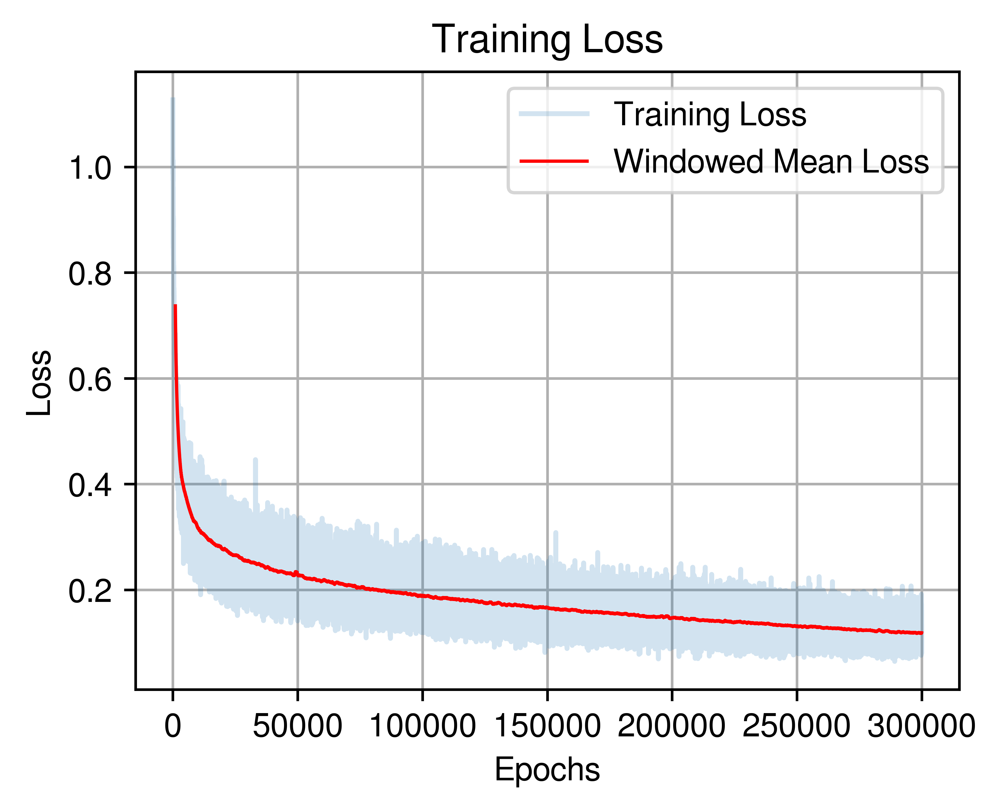

In [39]:
import matplotlib.pyplot as plt
import numpy as np

# Convert losses to a numpy array
losses_np = np.array([i.detach().cpu().numpy() for i in losses])

# Define the window size for the moving average
window_size = 1000  # You can adjust this value based on your preference

# Calculate the moving average (mean of the windowed losses)
windowed_mean_loss = np.convolve(losses_np, np.ones(window_size) / window_size, mode='valid')

# Adjust the x-axis values for the windowed mean loss
x_vals = np.linspace(0, len(losses_np), len(losses_np))
windowed_x_vals = x_vals[window_size - 1:]  # Adjust to match the length of the windowed_mean_loss

# Plotting
plt.figure(figsize=(4.5, 3.4), dpi=800)
plt.plot(x_vals, losses_np, label='Training Loss', alpha=0.2)
plt.plot(windowed_x_vals, windowed_mean_loss, label='Windowed Mean Loss', color='r', linewidth=1)

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()
plt.grid(True)
plt.show()


In [40]:
import argparse
import os

import numpy as np
import torch as th
import torch.distributed as dist

from Squidiff import dist_util, logger
from Squidiff.script_util import (
    NUM_CLASSES,
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    add_dict_to_argparser,
    args_to_dict,
)


def create_argparser():
    defaults = dict(
        clip_denoised=False,
        num_samples=2400,
        batch_size=16,
        use_ddim=False,
        model_path="model.pt",
    )
    defaults.update(model_and_diffusion_defaults())

    return defaults


In [42]:
args = create_argparser()
args.update({
    'data_dir': '/hpc/mydata/siyu.he/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 2400,
    'batch_size': 16,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 50,
    'save_interval': 1000,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 612, 
    'output_dim':612,
    'num_layers':3,
    'class_cond': False,  
    'use_ddim':True,
    'use_encoder':True,
    
})
#dist_util.setup_dist()

logger.configure(dir='logger_file')
logger.log("creating model and diffusion...")

model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )

model.load_state_dict(
    dist_util.load_state_dict(args['model_path'])
)
model.to(dist_util.dev())
if args['use_fp16']:
    model.convert_to_fp16()
model.eval()


Logging to logger_file
creating model and diffusion...


MLPModel(
  (encoder): EncoderMLPModel(
    (fc1): Linear(in_features=612, out_features=2048, bias=True)
    (bn1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (fc2): Linear(in_features=2048, out_features=2048, bias=True)
    (fc3): Linear(in_features=2048, out_features=60, bias=True)
    (label_embed): Linear(in_features=1, out_features=2048, bias=True)
  )
  (time_embed): Sequential(
    (0): Linear(in_features=2048, out_features=2048, bias=True)
    (1): SiLU()
    (2): Linear(in_features=2048, out_features=2048, bias=True)
  )
  (mlp_blocks): TimestepEmbedSequential(
    (0): MLPBlock(
      (fc1): Linear(in_features=2048, out_features=2048, bias=True)
      (fc2): Linear(in_features=2048, out_features=2048, bias=True)
      (layer_norm1): LayerNorm((2048,), eps=1e-05, elementwise_affine=True)
      (layer_norm2): LayerNorm((2048,), eps=1e-05, eleme

In [46]:
from Squidiff.scrna_datasets import load_gene_pert_data,prepared_data
import torch
data = load_VO_rad_drug_data(data_dir=args['data_dir'])

In [47]:
def stochastic_encode(
    model, x, t, model_kwargs):
    """
    ddim reverse sample
    """
    sample = x
    sample_t = []
    xstart_t = []
    T = []
    indices = list(range(t))

    for i in indices:
        timestep = torch.full((x.shape[0],), i, device='cuda').long()
        with torch.no_grad():
            out = diffusion.ddim_reverse_sample(model, 
                                                sample, 
                                                timestep, 
                                                model_kwargs=model_kwargs)
            sample = out['sample']
            sample_t.append(sample)
            xstart_t.append(out['pred_xstart'])
            T.append(timestep)

    return {
    'sample': sample,
    'sample_t': sample_t,
    'xstart_t': xstart_t,
    'T': T,
}


In [48]:
z_sem = model.encoder(torch.tensor(data[0].X.toarray()).to('cuda'),
                      #label = torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
                     )

model_kwargs = {'x_start':torch.tensor(data[0].X.toarray(), dtype = torch.float32).to('cuda'),
                'z_mod':z_sem,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }

x_T = stochastic_encode(model,
                  x = torch.tensor(data[0].X.toarray(), dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']


In [49]:
label = data[0].obs.values[:,0]

In [53]:
import umap
def plot_embed(x_,n_neighbors=50, min_dist=0.01, n_components=2, random_state=42,s=5):

    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components, random_state=random_state)
    embedding = reducer.fit_transform(x_.detach().cpu())
    plt.figure(figsize=(5,5), dpi=800)
    #hex_colors = [ '#fa2616','#3145a8','#7fa349', 
    #          '#ffc2c2','#99a9f7','#c4d9a5',]

    colorlist = ['#fa2616', '#ffc2c2','#ab4343','#654597','#7FB069']  # Colors for day 0 and day 3
    plt.scatter(embedding[label==0, 0], 
            embedding[label==0, 1], 
            c=colorlist[0],
            s=s,
            alpha=1)
    plt.scatter(embedding[label==1, 0], 
                embedding[label==1, 1], 
                c=colorlist[1],
                s=s,
                alpha=1)
    
    plt.scatter(embedding[label==2, 0], 
                embedding[label==2, 1], 
                c=colorlist[2],
                s=s,
                alpha=1)
    plt.scatter(embedding[label==3, 0], 
                embedding[label==3, 1], 
                c=colorlist[3],
                s=s,
                alpha=1)
    
    plt.axis('off')
    plt.show()

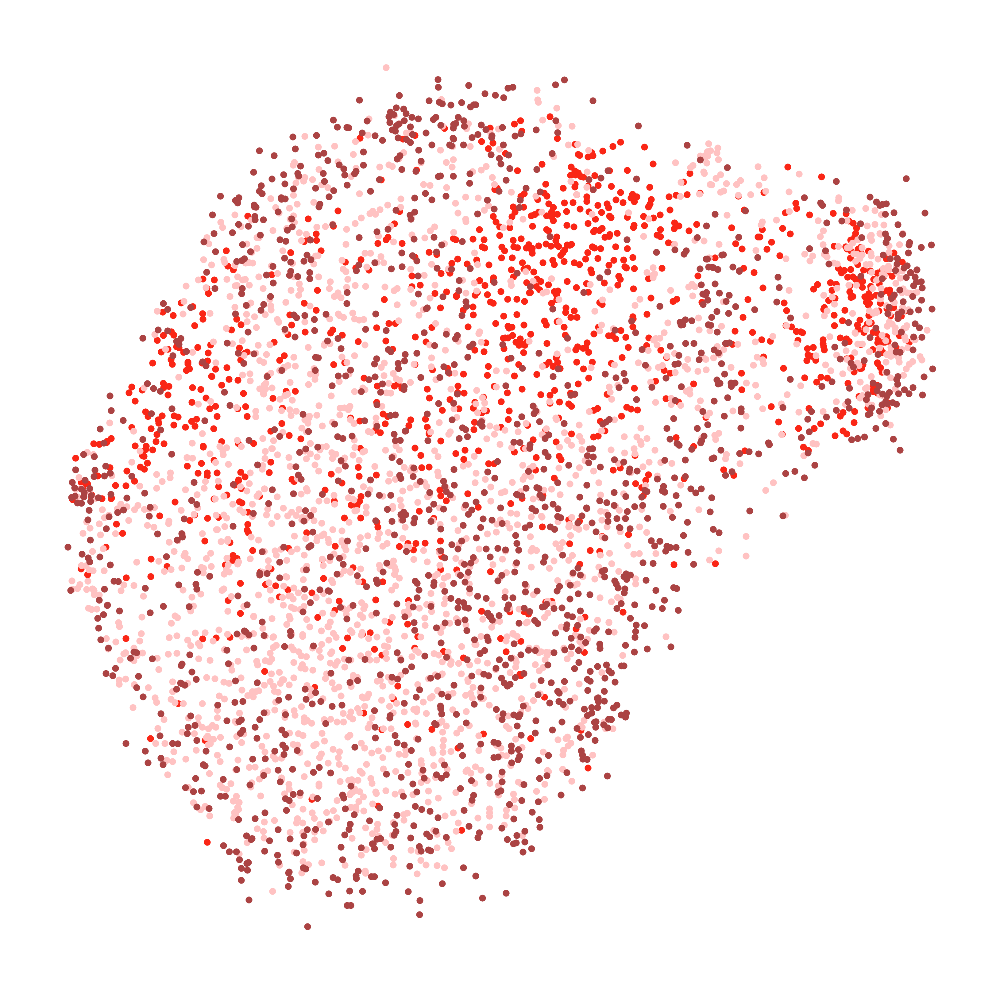

In [56]:
plot_embed(z_sem,s=1)

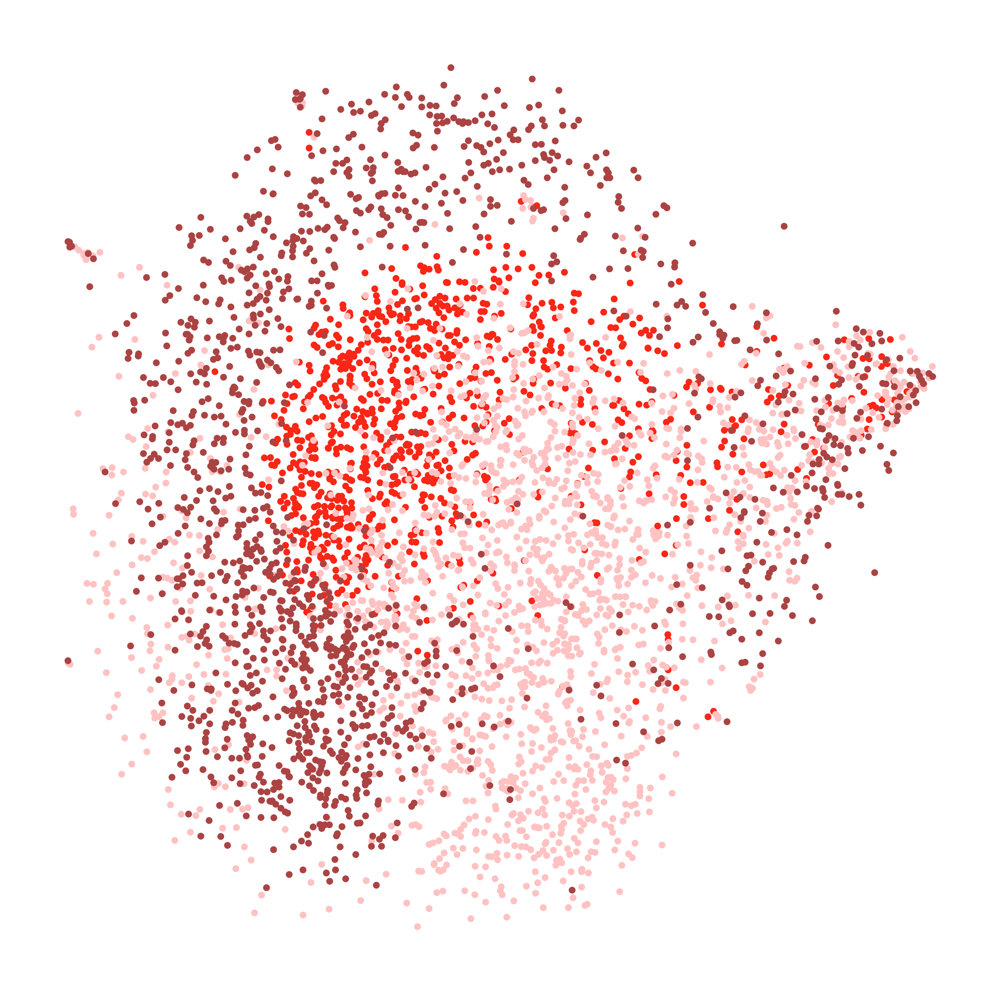

In [57]:
plot_embed(x_T,s=1)

In [58]:
logger.log("sampling...")
sample_fn = (diffusion.p_sample_loop if not args['use_ddim'] else diffusion.ddim_sample_loop)


sample_interp0 = sample_fn(
                    model,
                    shape = (len(z_sem), args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': z_sem},
                    noise =  None
)

sampling...


In [62]:
from scipy.stats import gaussian_kde
def display_reconst(df_true,
                    df_pred,
                    density=False,
                    den_all = False,
                    marker_genes=None,
                    sample_rate=0.1,
                    size=(4, 4),
                    spot_size=1,
                    title=None,
                    x_label='',
                    y_label='',
                    ):
    """
    Scatter plot - raw gexp vs. reconstructed gexp
    """
    assert 0 < sample_rate <= 1, \
        "Invalid downsampling rate for reconstruct scatter plot: {}".format(sample_rate)

    if marker_genes is not None:
        marker_genes = set(marker_genes)

    df_true_sample = df_true.sample(frac=sample_rate, random_state=0)
    df_pred_sample = df_pred.loc[df_true_sample.index]

    plt.rcParams["figure.figsize"] = size
    plt.figure(dpi=800)
    ax = plt.gca()

    xx = df_true_sample.T.to_numpy().flatten()
    yy = df_pred_sample.T.to_numpy().flatten()

    if density and not den_all:
        for gene in df_true_sample.columns:
            try:
                gene_true = df_true_sample[gene].values
                gene_pred = df_pred_sample[gene].values
                gexp_stacked = np.vstack([df_true_sample[gene].values, df_pred_sample[gene].values])

                z = gaussian_kde(gexp_stacked)(gexp_stacked)
                ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.5)
            except np.linalg.LinAlgError as e:
                pass

    elif marker_genes is not None:
        color_dict = {True: 'red', False: 'green'}
        gene_colors = np.vectorize(
            lambda x: color_dict[x in marker_genes]
        )(df_true_sample.columns)
        colors = np.repeat(gene_colors, df_true_sample.shape[0])

        ax.scatter(xx, yy, c=colors, s=spot_size, alpha=0.5)

    elif density and den_all:
        gene_true = df_true_sample.values.flatten()
        gene_pred = df_pred_sample.values.flatten()
        gexp_stacked = np.vstack([df_true_sample.values.flatten(), df_pred_sample.values.flatten()])
        z = gaussian_kde(gexp_stacked)(gexp_stacked)
        ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.5)
    else:
        ax.scatter(xx, yy, s=spot_size, alpha=0.5)
    
    min_val = min(xx.min(), yy.min())
    max_val = max(xx.max(), yy.max())
    #ax.set_xlim(min_val, 400)
    
    #ax.set_ylim(min_val, 400)
    ax.set_aspect('equal',adjustable='box')
    ax.axis('equal')
    ax.set_xlim(0, 10)
    ax.set_ylim(0, 10)
    plt.suptitle(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)

    plt.show()

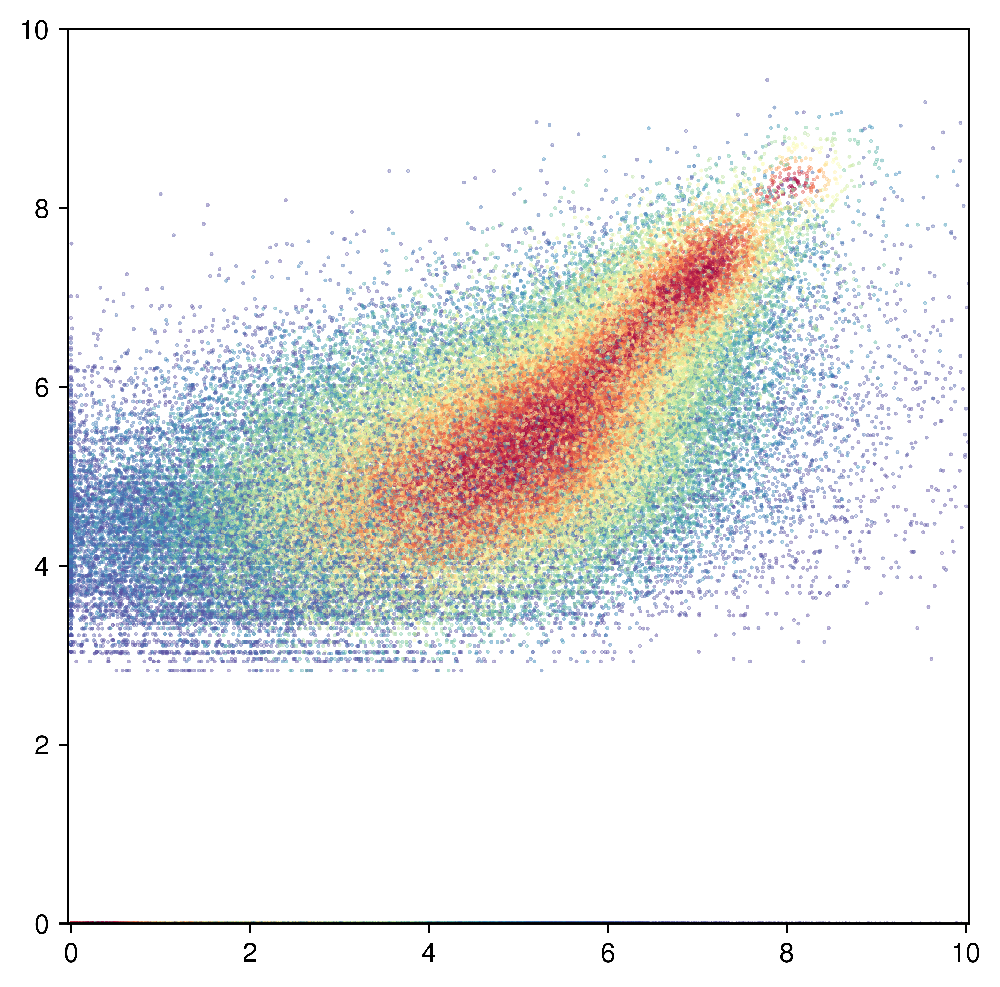

In [63]:

display_reconst(pd.DataFrame(sample_interp0.detach().cpu() ), 
                pd.DataFrame(data[0].X.toarray()),
                density=True,
                size=(6,6),
                spot_size=0.2,
                #den_all=True,
               )

In [64]:

direct_z_rad = z_sem[data[0].obs.values[:,0]==1].mean(axis=0) - z_sem[data[0].obs.values[:,0]==0].mean(axis=0)
direct_xT_rad = x_T[data[0].obs.values[:,0]==1].mean(axis=0) - x_T[data[0].obs.values[:,0]==0].mean(axis=0)

direct_z_drug_on_rad = z_sem[data[0].obs.values[:,0]==2].mean(axis=0) - z_sem[data[0].obs.values[:,0]==1].mean(axis=0)
direct_xT_drug_on_rad = x_T[data[0].obs.values[:,0]==2].mean(axis=0) - x_T[data[0].obs.values[:,0]==1].mean(axis=0)



In [66]:

z_sem_FB = model.encoder(torch.tensor(adata[(adata.obs['group_new']=='Control') & (adata.obs['Major_type']=='Fibroblast')].X.toarray()).to('cuda'))
model_kwargs = {'x_start':torch.tensor(adata[(adata.obs['group_new']=='Control') & (adata.obs['Major_type']=='Fibroblast')].X.toarray(), dtype = torch.float32).to('cuda'),
                'z_mod':z_sem_FB,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }
x_T_FB = stochastic_encode(model,
                  x = torch.tensor(adata[(adata.obs['group_new']=='Control') & (adata.obs['Major_type']=='Fibroblast')].X.toarray(), dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']

z_sem_mural = model.encoder(torch.tensor(adata[(adata.obs['group_new']=='Control') & (adata.obs['Major_type']=='Mural')].X.toarray()).to('cuda'))
model_kwargs = {'x_start':torch.tensor(adata[(adata.obs['group_new']=='Control') & (adata.obs['Major_type']=='Mural')].X.toarray(), dtype = torch.float32).to('cuda'),
                'z_mod':z_sem_mural,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }
x_T_mural = stochastic_encode(model,
                  x = torch.tensor(adata[(adata.obs['group_new']=='Control') & (adata.obs['Major_type']=='Mural')].X.toarray(), dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']


In [71]:
# interpolate
z_sem_FB_rad = z_sem_FB + direct_z_rad
z_sem_FB_rad_drug = z_sem_FB + direct_z_rad + direct_z_drug_on_rad

z_sem_mural_rad = z_sem_mural + direct_z_rad
z_sem_mural_rad_drug = z_sem_mural + direct_z_rad + direct_z_drug_on_rad

x_T_FB_rad = x_T_FB + direct_xT_rad
x_T_mural_rad = x_T_mural + direct_xT_rad 
x_T_FB_rad_drug = x_T_FB + direct_xT_rad + direct_xT_drug_on_rad
x_T_mural_rad_drug = x_T_mural + direct_xT_rad + direct_xT_drug_on_rad


sample_interp_FB_rad = sample_fn(
                            model,
                            shape = (len(z_sem_FB_rad), args['gene_size']),
                            clip_denoised=args['clip_denoised'],
                            model_kwargs={
                                'z_mod': torch.tensor(z_sem_FB_rad, dtype = torch.float32).to('cuda') 
                            },
                            noise =  x_T_FB_rad
        )

sample_interp_mural_rad = sample_fn(
                            model,
                            shape = (len(z_sem_mural_rad), args['gene_size']),
                            clip_denoised=args['clip_denoised'],
                            model_kwargs={
                                'z_mod': torch.tensor(z_sem_mural_rad, dtype = torch.float32).to('cuda') 
                            },
                            noise =  x_T_mural_rad
        )

sample_interp_FB_rad_drug = sample_fn(
                            model,
                            shape = (len(z_sem_FB_rad_drug), args['gene_size']),
                            clip_denoised=args['clip_denoised'],
                            model_kwargs={
                                'z_mod': torch.tensor(z_sem_FB_rad_drug, dtype = torch.float32).to('cuda') 
                            },
                            noise =  x_T_FB_rad_drug
        )

sample_interp_mural_rad_drug = sample_fn(
                            model,
                            shape = (len(z_sem_mural_rad_drug), args['gene_size']),
                            clip_denoised=args['clip_denoised'],
                            model_kwargs={
                                'z_mod': torch.tensor(z_sem_mural_rad_drug, dtype = torch.float32).to('cuda') 
                            },
                            noise =  x_T_mural_rad_drug
        )

(-0.2, 10.0)

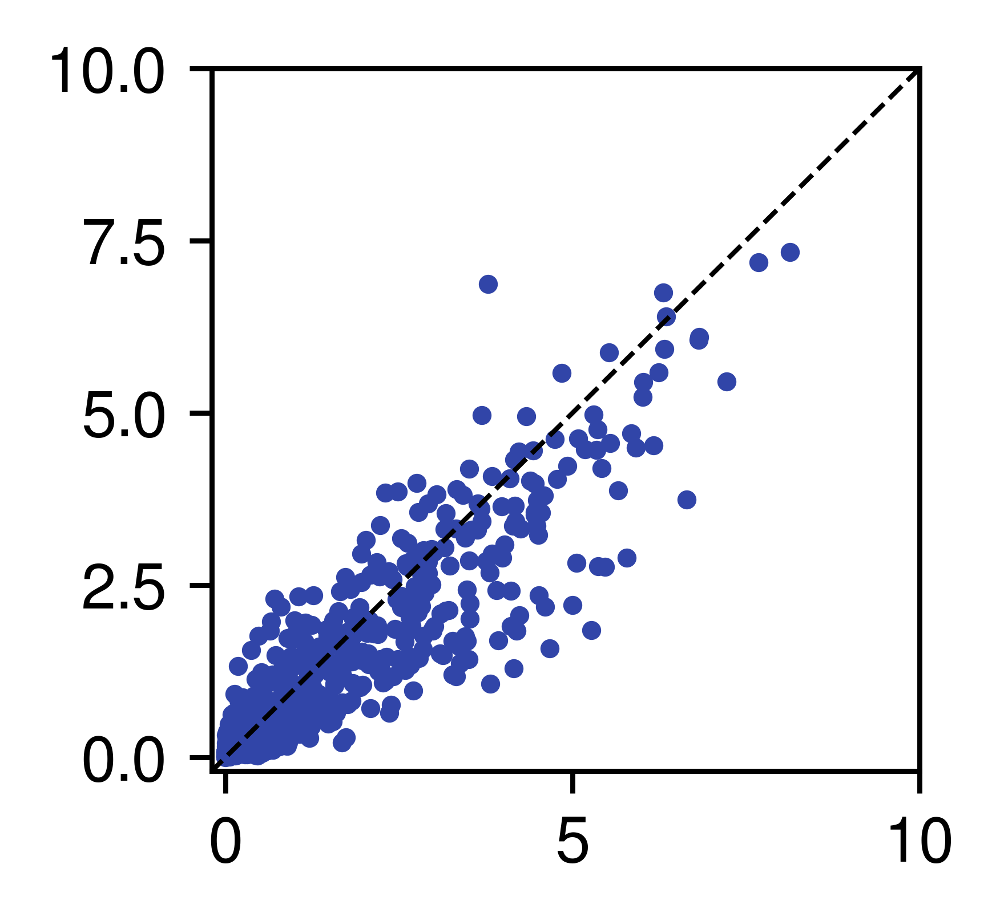

In [81]:
    #hex_colors = [ '#fa2616','#3145a8','#7fa349', 
    #          '#ffc2c2','#99a9f7','#c4d9a5',]

plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(np.array(adata[(adata.obs['group_new']=='Rad') & (adata.obs['Major_type']=='Fibroblast')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0),
            s=4,
            c='#3145a8'
           )
plt.plot(np.linspace(-1,15,100),
         np.linspace(-1,15,100),
         '--',
         color='k',
         linewidth = 0.75,
        )
plt.xlim([-0.2,10])
plt.ylim([-0.2,10])

In [82]:
import scipy
from sklearn.metrics import r2_score
p_ , _ = scipy.stats.pearsonr(
        np.array(adata[(adata.obs['group_new']=='Rad') & (adata.obs['Major_type']=='Fibroblast')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )

r_= r2_score(
np.array(adata[(adata.obs['group_new']=='Rad') & (adata.obs['Major_type']=='Fibroblast')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )
print(p_)
print(r_)

0.8996118402916581
0.784631609916687


(-0.2, 10.0)

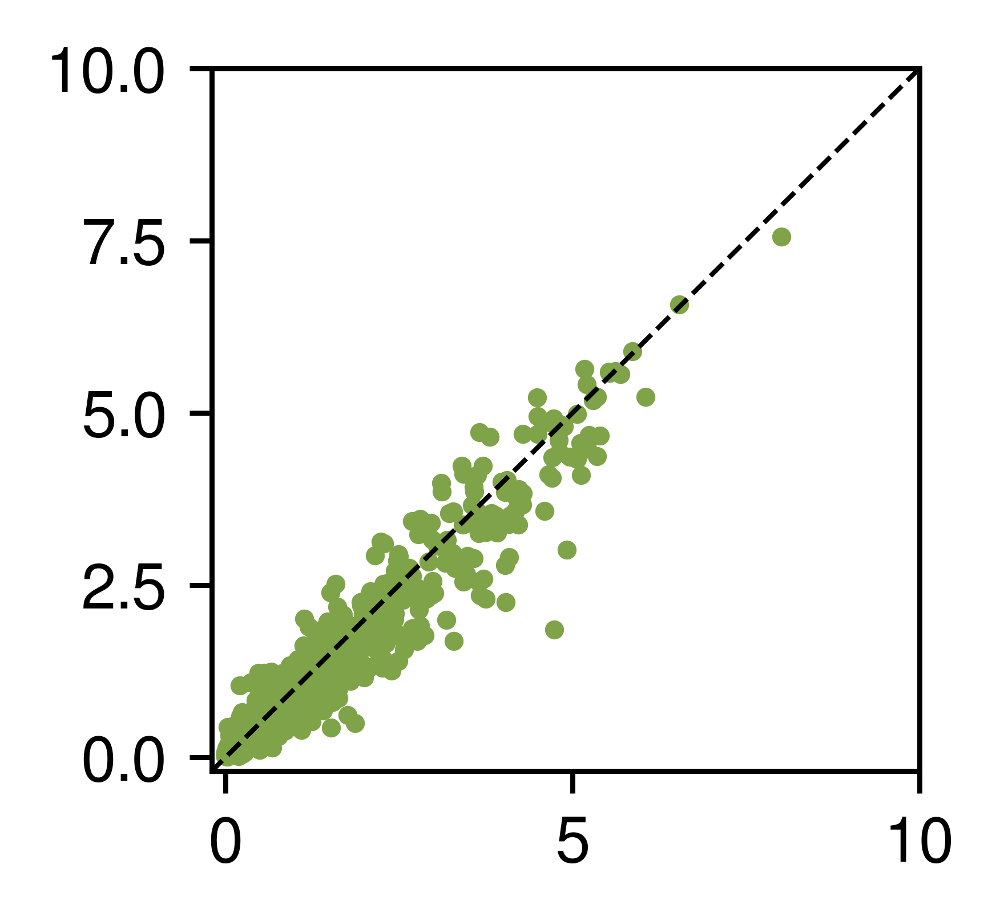

In [83]:
plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(np.array(adata[(adata.obs['group_new']=='Rad') & (adata.obs['Major_type']=='Mural')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_mural_rad.detach().cpu().numpy().mean(axis=0),
            s=4,
            c='#7fa349'
           )
plt.plot(np.linspace(-1,15,100),
         np.linspace(-1,15,100),
         '--',
         color='k',
         linewidth = 0.75,
        )
plt.xlim([-0.2,10])
plt.ylim([-0.2,10])

In [80]:
import scipy
from sklearn.metrics import r2_score
p_ , _ = scipy.stats.pearsonr(
np.array(adata[(adata.obs['group_new']=='Rad') & (adata.obs['Major_type']=='Mural')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_mural_rad.detach().cpu().numpy().mean(axis=0),
                                )

r_= r2_score(
np.array(adata[(adata.obs['group_new']=='Rad') & (adata.obs['Major_type']=='Mural')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_mural_rad.detach().cpu().numpy().mean(axis=0),
                                )
print(p_)
print(r_)

0.9586333476247958
0.9136733412742615


0.9078027089848293
0.7698231935501099


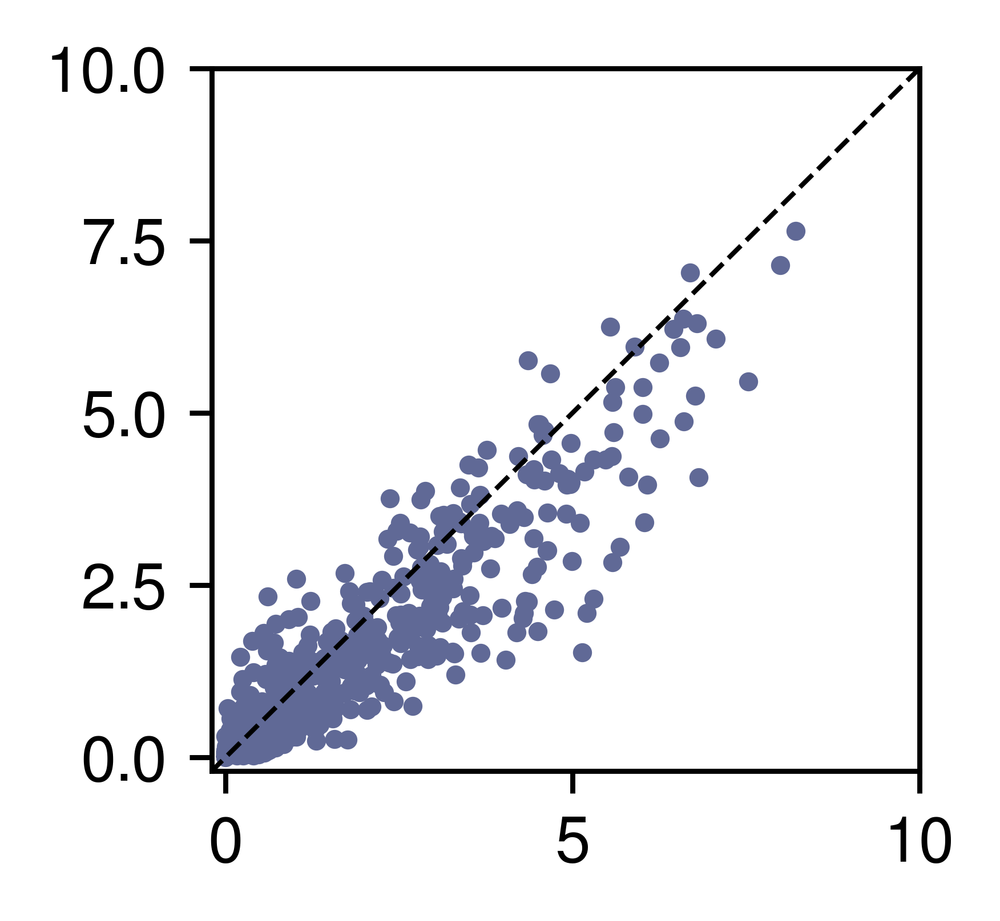

In [87]:
plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(np.array(adata[(adata.obs['group_new']=='Rad&Drug') & (adata.obs['Major_type']=='Fibroblast')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_FB_rad_drug.detach().cpu().numpy().mean(axis=0),
            s=4,
            c= '#606996',
           )
plt.plot(np.linspace(-1,15,100),
         np.linspace(-1,15,100),
         '--',
         color='k',
         linewidth = 0.75,
        )
plt.xlim([-0.2,10])
plt.ylim([-0.2,10])

from sklearn.metrics import r2_score
p_ , _ = scipy.stats.pearsonr(
        np.array(adata[(adata.obs['group_new']=='Rad&Drug') & (adata.obs['Major_type']=='Fibroblast')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )

r_= r2_score(
np.array(adata[(adata.obs['group_new']=='Rad&Drug') & (adata.obs['Major_type']=='Fibroblast')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )
print(p_)
print(r_)

0.9606886920385534
0.9227750301361084


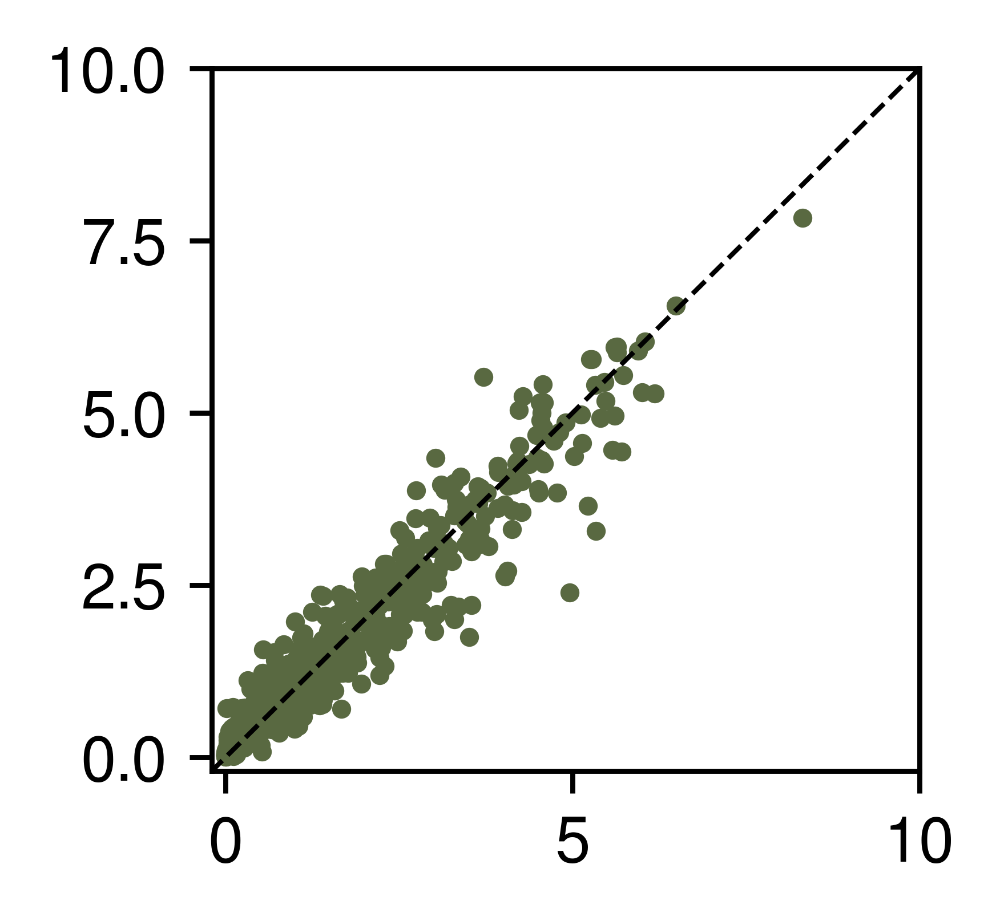

In [88]:
plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(np.array(adata[(adata.obs['group_new']=='Rad&Drug') & (adata.obs['Major_type']=='Mural')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_mural_rad_drug.detach().cpu().numpy().mean(axis=0),
            s=4,
            c='#596941',
           )
plt.plot(np.linspace(-1,15,100),
         np.linspace(-1,15,100),
         '--',
         color='k',
         linewidth = 0.75,
        )
plt.xlim([-0.2,10])
plt.ylim([-0.2,10])

from sklearn.metrics import r2_score
p_ , _ = scipy.stats.pearsonr(
        np.array(adata[(adata.obs['group_new']=='Rad&Drug') & (adata.obs['Major_type']=='Mural')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_mural_rad_drug.detach().cpu().numpy().mean(axis=0)
                    )

r_= r2_score(
np.array(adata[(adata.obs['group_new']=='Rad&Drug') & (adata.obs['Major_type']=='Mural')].copy()[:,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_mural_rad_drug.detach().cpu().numpy().mean(axis=0)
                    )
print(p_)
print(r_)

In [120]:
sample_interp = anndata.AnnData(torch.concat([
    torch.tensor(adata[(adata.obs['Major_type']=='EC')&(adata.obs['group_new']=='Rad')].to_df().values).to('cuda'),
    
    sample_interp_FB_rad, 
      sample_interp_mural_rad,
     torch.tensor(adata[(adata.obs['Major_type']=='EC')&(adata.obs['group_new']=='Rad&Drug')].to_df().values).to('cuda'),
      sample_interp_FB_rad_drug,
      sample_interp_mural_rad_drug],axis=0).detach().cpu().numpy()
                               )
sample_interp.obs['cell_type'] = ['EC'] * adata[(adata.obs['Major_type']=='EC')&(adata.obs['group_new']=='Rad')].shape[0] + ['FB'] * sample_interp_FB_rad.shape[0] + ['Mural'] * sample_interp_mural_rad.shape[0] +['EC'] * adata[(adata.obs['Major_type']=='EC')&(adata.obs['group_new']=='Rad&Drug')].shape[0]+ ['FB'] * sample_interp_FB_rad.shape[0] + ['Mural'] * sample_interp_mural_rad.shape[0]
sample_interp.obs['conditions'] = ['rad'] * adata[(adata.obs['Major_type']=='EC')&(adata.obs['group_new']=='Rad')].shape[0] + ['rad'] * sample_interp_FB_rad.shape[0] + ['rad'] * sample_interp_mural_rad.shape[0] + ['rad_drug'] * adata[(adata.obs['Major_type']=='EC')&(adata.obs['group_new']=='Rad&Drug')].shape[0]+['rad_drug'] * sample_interp_FB_rad.shape[0] + ['rad_drug'] * sample_interp_mural_rad.shape[0]

sample_interp.write('/hpc/mydata/siyu.he/squidward_study/results/fig6/sample_interp_rad_drug.h5ad')

In [25]:
sample_interp = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/results/fig6/sample_interp_rad_drug.h5ad')

In [26]:
sample_interp.obs

,cell_type,conditions
0,EC,rad
1,EC,rad
2,EC,rad
3,EC,rad
4,EC,rad
...,...,...
14161,Mural,rad_drug
14162,Mural,rad_drug
14163,Mural,rad_drug
14164,Mural,rad_drug


In [27]:
def filter_deg(temp, cell_type, p_value_threshold, logFC_threshold):
    degs  = pd.DataFrame(temp.uns['rank_genes_groups']['names'])
    pvals = pd.DataFrame(temp.uns['rank_genes_groups']['pvals'])
    logfc = pd.DataFrame(temp.uns['rank_genes_groups']['logfoldchanges'])
    
    up_genes = degs[(pvals['rad_drug'] < p_value_threshold) & (logfc['rad_drug'] > logFC_threshold)][['rad_drug']]
    down_genes = degs[(pvals['rad_drug'] < p_value_threshold) & (logfc['rad_drug'] < -logFC_threshold)][['rad_drug']]
    
    up_genes.loc[:,'pvals'] = pvals.loc[up_genes.index, 'rad_drug']
    up_genes.loc[:,'logFC'] = logfc.loc[up_genes.index, 'rad_drug']
    up_genes.loc[:,'cell_type'] = cell_type
    
    down_genes.loc[:,'pvals'] = pvals.loc[down_genes.index, 'rad_drug']
    down_genes.loc[:,'logFC'] = logfc.loc[down_genes.index, 'rad_drug']
    down_genes.loc[:,'cell_type'] = cell_type
    
    return up_genes, down_genes

def get_dge(temp, cell_types, condition="rad_drug"):
    deg_up_df_ = pd.DataFrame()
    deg_down_df_ = pd.DataFrame()
    
    p_value_threshold = 0.05
    logFC_threshold = 0.25

    for cell_type in cell_types:
        # Filter cells based on cell type
        temp_ct = temp[temp.obs['cell_type'] == cell_type].copy()
        
        # Perform ranking genes groups for each cell type
        sc.tl.rank_genes_groups(temp_ct, groupby="conditions", method="wilcoxon")
        
        # Filter DEGs
        up_genes, down_genes = filter_deg(temp_ct, cell_type, p_value_threshold, logFC_threshold)
        deg_up_df_ = pd.concat([deg_up_df_, up_genes])
        deg_down_df_ = pd.concat([deg_down_df_, down_genes])

    # Set column names once after loop
    deg_up_df_.columns = ['Gene', 'pvals', 'logFC', 'cell_type']
    deg_down_df_.columns = ['Gene', 'pvals', 'logFC', 'cell_type']

    # Combine all DEGs into one DataFrame and calculate mean p-values and logFC
    deg_combined = pd.concat([deg_up_df_, deg_down_df_])
    deg_combined = deg_combined.groupby(['Gene', 'cell_type']).agg({'pvals': 'mean', 'logFC': 'mean'}).reset_index()

    return deg_combined

# Example usage
cell_types = ['EC', 'FB', 'Mural']
sample_interp.var_names = adata.var_names
# Assume 'adata' is your annotated data object
deg_combined_all = get_dge(sample_interp, cell_types)

In [28]:
deg_combined_all

,Gene,cell_type,pvals,logFC
0,ABL2,EC,1.053780e-15,-0.454947
1,ABL2,Mural,8.936087e-25,-0.280387
2,ACKR3,EC,6.018103e-05,0.648206
3,ACKR3,FB,1.338955e-28,0.301221
4,ACSM3,EC,2.589836e-06,1.018680
...,...,...,...,...
644,ZFP36,Mural,1.277585e-15,0.309661
645,ZIC1,FB,1.133222e-24,2.158544
646,ZIC1,Mural,2.019015e-20,1.032595
647,ZIC5,FB,9.208355e-06,-0.293961


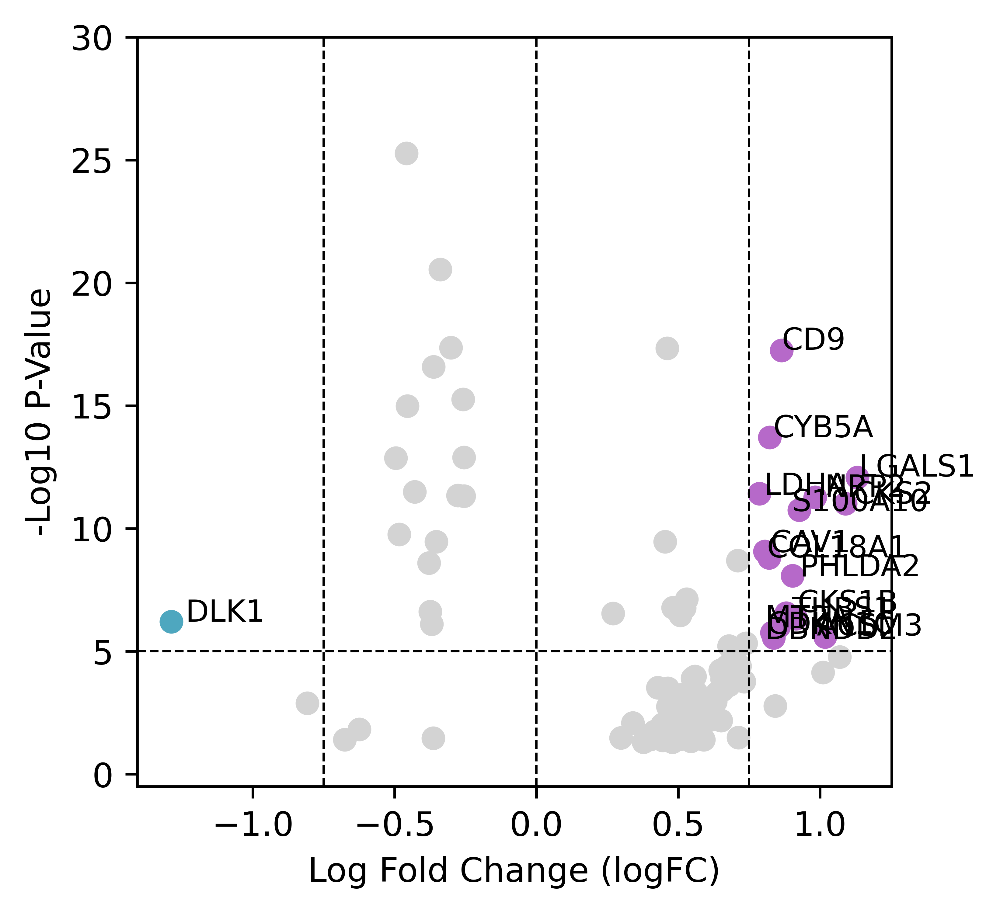

In [29]:
import random
deg_combined = deg_combined_all[deg_combined_all['cell_type'] == 'EC']

plt.figure(figsize=(4, 4), dpi=800)
plt.scatter(deg_combined['logFC'], -np.log10(deg_combined['pvals']), color='lightgrey')

highlight_genes_up = deg_combined[(deg_combined['logFC'] > 0.75) & (deg_combined['pvals'] < 0.00001)]
highlight_genes_down = deg_combined[(deg_combined['logFC'] < -0.75) & (deg_combined['pvals'] < 0.00001)]
def adjust_text_position(x, y, text, offset_range=(-0.05, 0.05)):
    offset_x = random.uniform(*offset_range)
    offset_y = random.uniform(*offset_range)
    plt.text(x + offset_x, y + offset_y, text, fontsize=9)

for i, row in highlight_genes_up.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#b669c9')
    adjust_text_position(row['logFC'], -np.log10(row['pvals']), row['Gene'])

# Plot and label the downregulated genes
for i, row in highlight_genes_down.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#4ea7bf')
    adjust_text_position(row['logFC'], -np.log10(row['pvals']), row['Gene'])

plt.xlabel('Mean Log Fold Change (logFC)')
plt.ylabel('-Log10 Mean P-Value')
plt.axvline(x=0.75, color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=-0.75, color='black', linestyle='--', linewidth=0.7)
plt.axhline(y=-np.log10(0.00001), color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=0, color='black', linestyle='--', linewidth=0.7)
plt.ylim([-0.5,30])
plt.xlabel('Log Fold Change (logFC)')
plt.ylabel('-Log10 P-Value')
plt.grid(False)
plt.show()

In [30]:
highlight_genes_up

,Gene,cell_type,pvals,logFC
4,ACSM3,EC,2.589836e-06,1.018680
76,CAV1,EC,8.546125e-10,0.805689
94,CD9,EC,5.655668e-18,0.864988
107,CDKN1C,EC,1.751973e-06,0.830151
126,CKS1B,EC,2.825348e-07,0.880918
129,CKS2,EC,9.869866e-12,1.090603
140,COL18A1,EC,1.546235e-09,0.820661
179,CYB5A,EC,1.949271e-14,0.823360
184,DBNDD2,EC,2.819606e-06,0.837353
340,LDHA,EC,3.799041e-12,0.786837


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_780930/2534883850.py:15: RuntimeWarning: divide by zero encountered in log10
  plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#b669c9')
/tmp/ipykernel_780930/2534883850.py:16: RuntimeWarning: divide by zero encountered in log10
  adjust_text_position(row['logFC'], -np.log10(row['pvals']), row['Gene'])
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


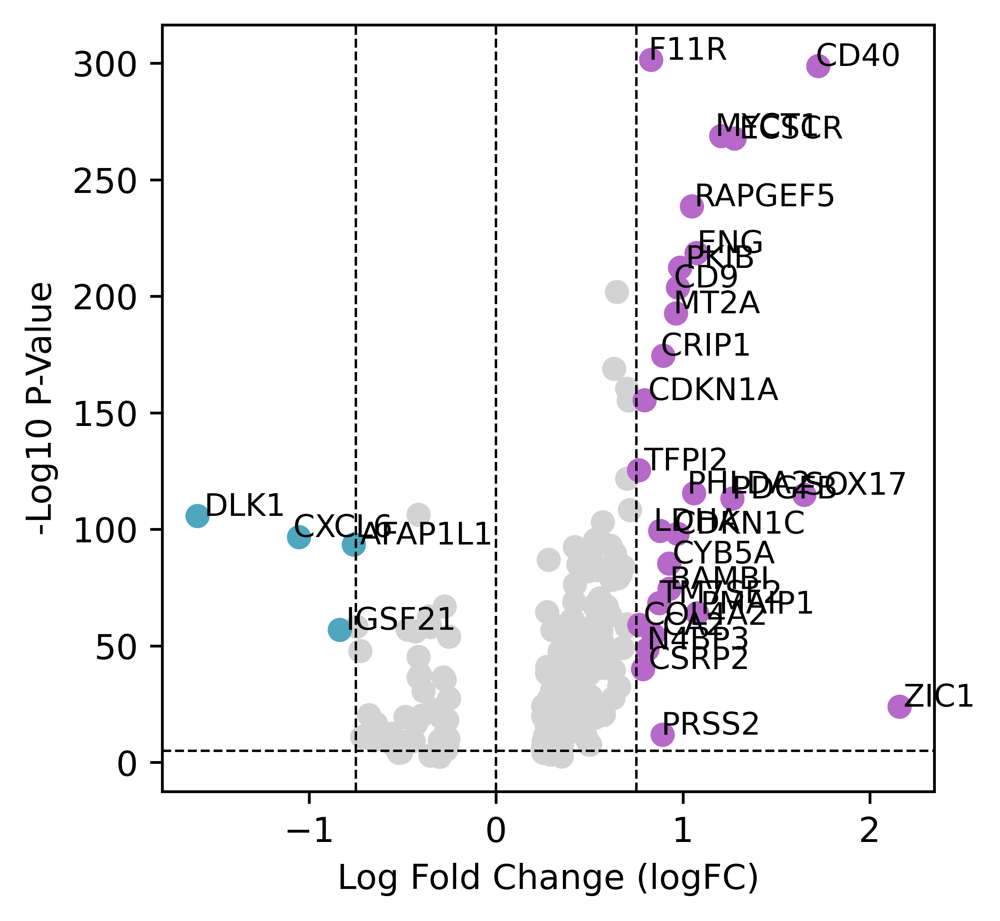

In [36]:
import random
deg_combined = deg_combined_all[deg_combined_all['cell_type'] == 'FB']

plt.figure(figsize=(4, 4), dpi=800)
plt.scatter(deg_combined['logFC'], -np.log10(deg_combined['pvals']), color='lightgrey')

highlight_genes_up = deg_combined[(deg_combined['logFC'] > 0.75) & (deg_combined['pvals'] < 0.00001)]
highlight_genes_down = deg_combined[(deg_combined['logFC'] < -0.75) & (deg_combined['pvals'] < 0.00001)]
def adjust_text_position(x, y, text, offset_range=(-0.05, 0.05)):
    offset_x = random.uniform(*offset_range)
    offset_y = random.uniform(*offset_range)
    plt.text(x + offset_x, y + offset_y, text, fontsize=9)

for i, row in highlight_genes_up.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#b669c9')
    adjust_text_position(row['logFC'], -np.log10(row['pvals']), row['Gene'])

# Plot and label the downregulated genes
for i, row in highlight_genes_down.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#4ea7bf')
    adjust_text_position(row['logFC'], -np.log10(row['pvals']), row['Gene'])

plt.xlabel('Mean Log Fold Change (logFC)')
plt.ylabel('-Log10 Mean P-Value')
plt.axvline(x=0.75, color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=-0.75, color='black', linestyle='--', linewidth=0.7)
plt.axhline(y=-np.log10(0.00001), color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=0, color='black', linestyle='--', linewidth=0.7)
#plt.ylim([-0.5,30])
plt.xlabel('Log Fold Change (logFC)')
plt.ylabel('-Log10 P-Value')
plt.grid(False)
plt.show()

In [37]:
highlight_genes_up

,Gene,cell_type,pvals,logFC
55,BAMBI,FB,3.266656e-75,0.927562
71,CA2,FB,1.787507e-55,0.840584
77,CAV1,FB,0.000000e+00,2.215952
89,CD40,FB,1.382872e-299,1.723446
95,CD9,FB,1.991457e-204,0.972730
105,CDKN1A,FB,3.181045e-156,0.793608
108,CDKN1C,FB,5.875700e-99,0.971310
134,CLDN5,FB,0.000000e+00,1.088247
143,COL4A2,FB,7.844825e-60,0.765531
164,CRIP1,FB,2.916370e-175,0.893430


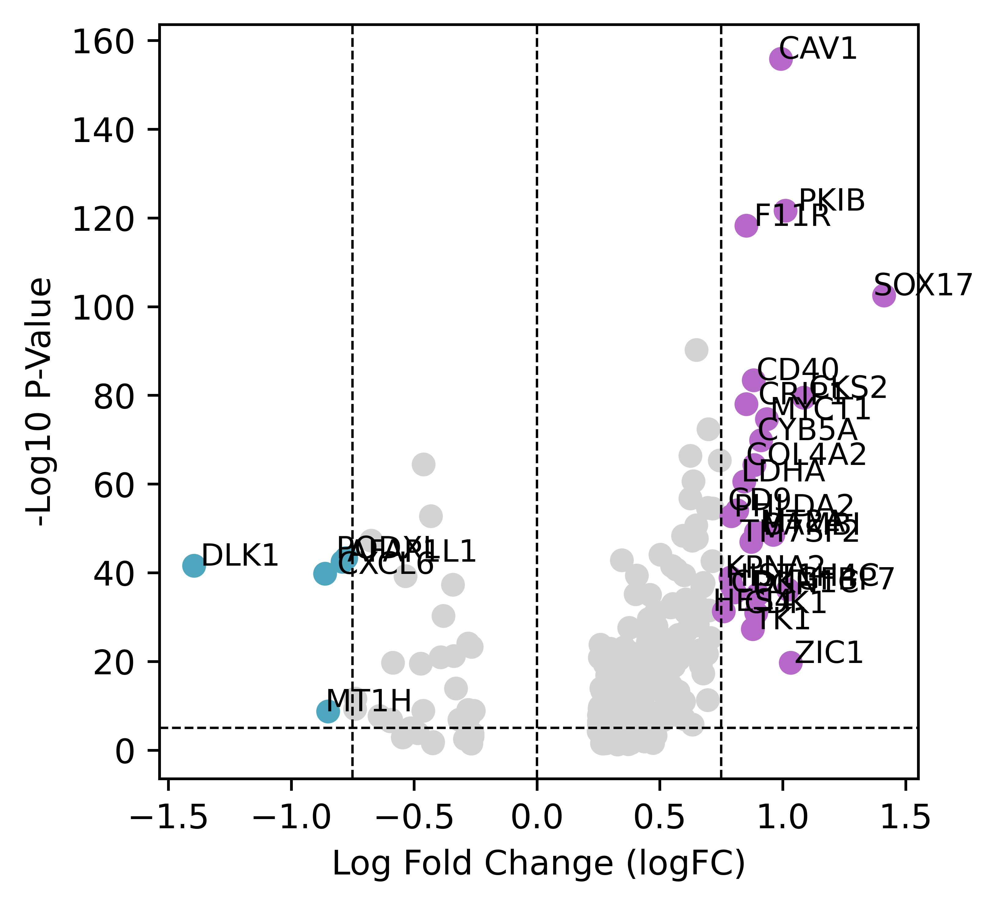

In [38]:
import random
deg_combined = deg_combined_all[deg_combined_all['cell_type'] == 'Mural']

plt.figure(figsize=(4, 4), dpi=800)
plt.scatter(deg_combined['logFC'], -np.log10(deg_combined['pvals']), color='lightgrey')

highlight_genes_up = deg_combined[(deg_combined['logFC'] > 0.75) & (deg_combined['pvals'] < 0.00001)]
highlight_genes_down = deg_combined[(deg_combined['logFC'] < -0.75) & (deg_combined['pvals'] < 0.00001)]
def adjust_text_position(x, y, text, offset_range=(-0.05, 0.05)):
    offset_x = random.uniform(*offset_range)
    offset_y = random.uniform(*offset_range)
    plt.text(x + offset_x, y + offset_y, text, fontsize=9)

for i, row in highlight_genes_up.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#b669c9')
    adjust_text_position(row['logFC'], -np.log10(row['pvals']), row['Gene'])

# Plot and label the downregulated genes
for i, row in highlight_genes_down.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#4ea7bf')
    adjust_text_position(row['logFC'], -np.log10(row['pvals']), row['Gene'])

plt.xlabel('Mean Log Fold Change (logFC)')
plt.ylabel('-Log10 Mean P-Value')
plt.axvline(x=0.75, color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=-0.75, color='black', linestyle='--', linewidth=0.7)
plt.axhline(y=-np.log10(0.00001), color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=0, color='black', linestyle='--', linewidth=0.7)
#plt.ylim([-0.5,30])
plt.xlabel('Log Fold Change (logFC)')
plt.ylabel('-Log10 P-Value')
plt.grid(False)
plt.show()

In [62]:
deg_combined_all

,Gene,cell_type,pvals,logFC
0,ABL2,EC,1.053780e-15,-0.454947
1,ABL2,Mural,8.936087e-25,-0.280387
2,ACKR3,EC,6.018103e-05,0.648206
3,ACKR3,FB,1.338955e-28,0.301221
4,ACSM3,EC,2.589836e-06,1.018680
...,...,...,...,...
644,ZFP36,Mural,1.277585e-15,0.309661
645,ZIC1,FB,1.133222e-24,2.158544
646,ZIC1,Mural,2.019015e-20,1.032595
647,ZIC5,FB,9.208355e-06,-0.293961


In [67]:
pip install matplotlib-venn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.3/40.3 kB 2.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for matplotlib-venn: filename=matplotlib_venn-1.1.1-py3-none-any.whl size=45286 sha256=31c22dff1c5b6b7c3120e390d9c2de84f099c2b16e0a1e4a0ba2cdaf97ca4335
  Stored in directory: /hpc/mydata/siyu.he/.cache/pip/wheels/5c/4b/48/d68a6531b1e1e7411520ab9f395994eb1ee2ffafd6837b7f6c
Successfully built matplotlib-venn
Note: you may need to restart the kernel to use updated packages.


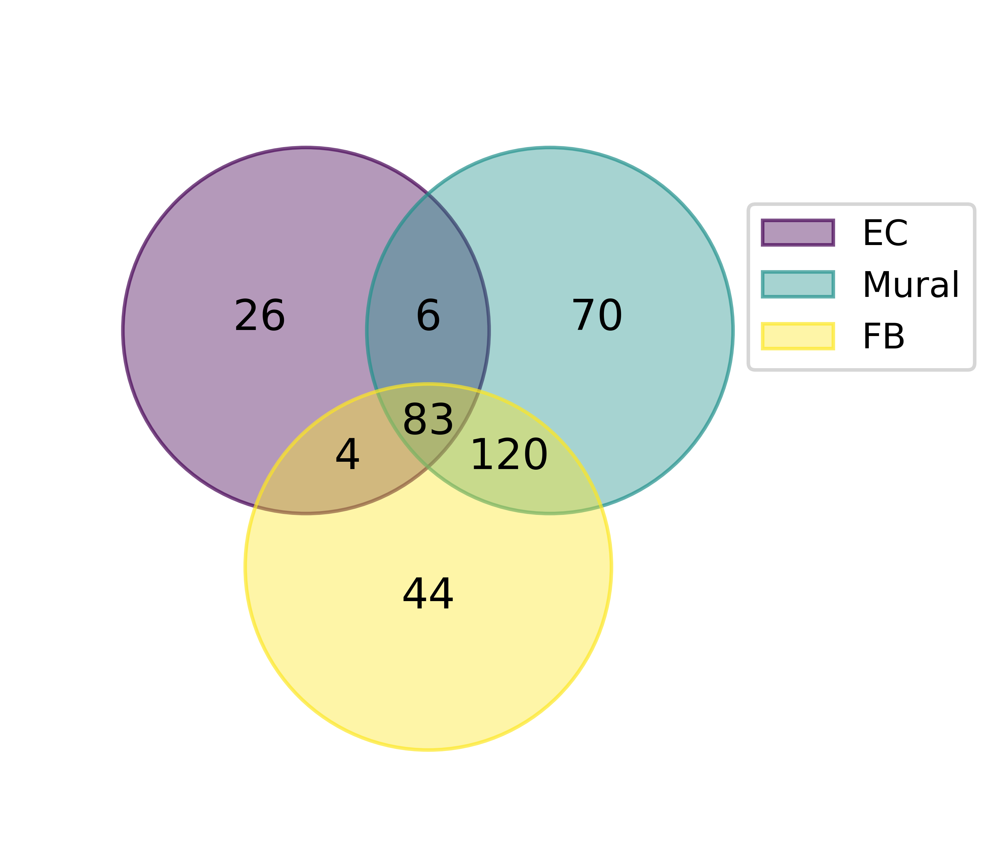

In [69]:
# Identify unique genes shared across cell types

from matplotlib_venn import venn2, venn3
from venn import venn


df = deg_combined_all.copy()
shared_genes_ec = set(df[df['cell_type'] == 'EC']['Gene'])
shared_genes_mural = set(df[df['cell_type'] == 'Mural']['Gene'])
shared_genes_fb = set(df[df['cell_type'] == 'FB']['Gene'])


DEG_list_venn = {}
DEG_list_venn['EC'] =  shared_genes_ec
DEG_list_venn['Mural'] = shared_genes_mural
DEG_list_venn['FB'] = shared_genes_fb

fig,ax = plt.subplots(1,1,figsize=(4,4),dpi=800)
venn(DEG_list_venn, 
         fontsize=12, 
         legend_loc="right", 
         ax=ax)
# Get the Axes object from the Venn diagram
ax = plt.gca()
# Adjust the legend position using loc parameter
ax.legend(DEG_list_venn.keys(),bbox_to_anchor=(1.2, 0.8))
plt.tight_layout()
plt.show()
    


In [59]:

def get_rank(df_, gene):
    df_rank = []
    for i in df_.columns:  
        df_rank.append(list(df_[i].values).index(gene))
    return df_rank

def plot_rank_up(gene):
    temp_ec = get_rank(deg_up_df_EC, gene)
    temp_fb = get_rank(deg_up_df_FB, gene)
    temp_mural = get_rank(deg_up_df_mural, gene)    
    time_ = [-1, 1, 3, 5, 7, 9, 11, 13, 15, 17]
    
    fig, ax = plt.subplots(1, 1, figsize=(4, 1.5), dpi=800)
    ax.plot(time_, temp_ec, marker='o', linestyle='-', color='#fa2616')  # Line plot with markers
    ax.plot(time_, temp_fb, marker='o', linestyle='-', color='#3145a8')  # Plot the data points with lines connecting them
    ax.plot(time_, temp_mural, marker='o', linestyle='-', color='#7fa349')  # Plot the data points with lines connecting them
    
    ax.set_title(gene)
    ax.set_xlabel('Day')
    ax.set_ylabel('Ranking')
    ax.invert_yaxis()
    ax.set_xticks(time_)  # Ensure all time points are displayed on the x-axis

    plt.show()
    

def plot_rank_down(gene):
    temp_ec = get_rank(deg_down_df_EC, gene)
    temp_fb = get_rank(deg_down_df_FB, gene)
    temp_mural = get_rank(deg_down_df_mural, gene)    
    time_ = [-1, 1, 3, 5, 7, 9, 11, 13, 15, 17]
    
    fig, ax = plt.subplots(1, 1, figsize=(4, 1.5), dpi=800)
    ax.plot(time_, temp_ec, marker='o', linestyle='-', color='#fa2616')  # Line plot with markers
    ax.plot(time_, temp_fb, marker='o', linestyle='-', color='#3145a8')  # Plot the data points with lines connecting them
    ax.plot(time_, temp_mural, marker='o', linestyle='-', color='#7fa349')  # Plot the data points with lines connecting them
    
    ax.set_title(gene)
    ax.set_xlabel('Day')
    ax.set_ylabel('Ranking')
    ax.invert_yaxis()
    ax.set_xticks(time_)  # Ensure all time points are displayed on the x-axis

    plt.show()

In [61]:
plot_rank_up('AK4')

NameError: name 'deg_up_df_EC' is not defined

In [71]:
deg_combined_all

,Gene,cell_type,pvals,logFC
0,ABL2,EC,1.053780e-15,-0.454947
1,ABL2,Mural,8.936087e-25,-0.280387
2,ACKR3,EC,6.018103e-05,0.648206
3,ACKR3,FB,1.338955e-28,0.301221
4,ACSM3,EC,2.589836e-06,1.018680
...,...,...,...,...
644,ZFP36,Mural,1.277585e-15,0.309661
645,ZIC1,FB,1.133222e-24,2.158544
646,ZIC1,Mural,2.019015e-20,1.032595
647,ZIC5,FB,9.208355e-06,-0.293961


In [72]:
df = deg_combined_all.copy()
shared_genes_ec = set(df[(df['cell_type'] == 'EC') & (df['logFC']>0)]['Gene'])
shared_genes_mural = set(df[(df['cell_type'] == 'Mural')& (df['logFC']>0)]['Gene'])
shared_genes_fb = set(df[(df['cell_type'] == 'FB')& (df['logFC']>0)]['Gene'])


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


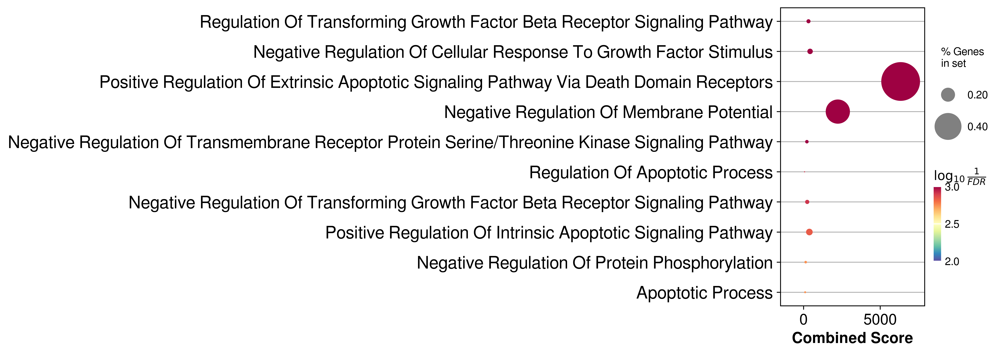

In [83]:

import torch
import torch.nn.functional as F
import torch.nn as nn

from torch.utils.data import DataLoader, TensorDataset

import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns
import matplotlib.font_manager
from matplotlib import rcParams

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'
rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 800})
rcParams.update({'figure.figsize': (3,3)})
rcParams.update({'savefig.dpi': 800})

import gseapy as gp

gene_list = shared_genes_ec & shared_genes_mural
gene_list = gene_list & shared_genes_fb
enr_up = gp.enrichr(list(gene_list),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=10)
plt.show()

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


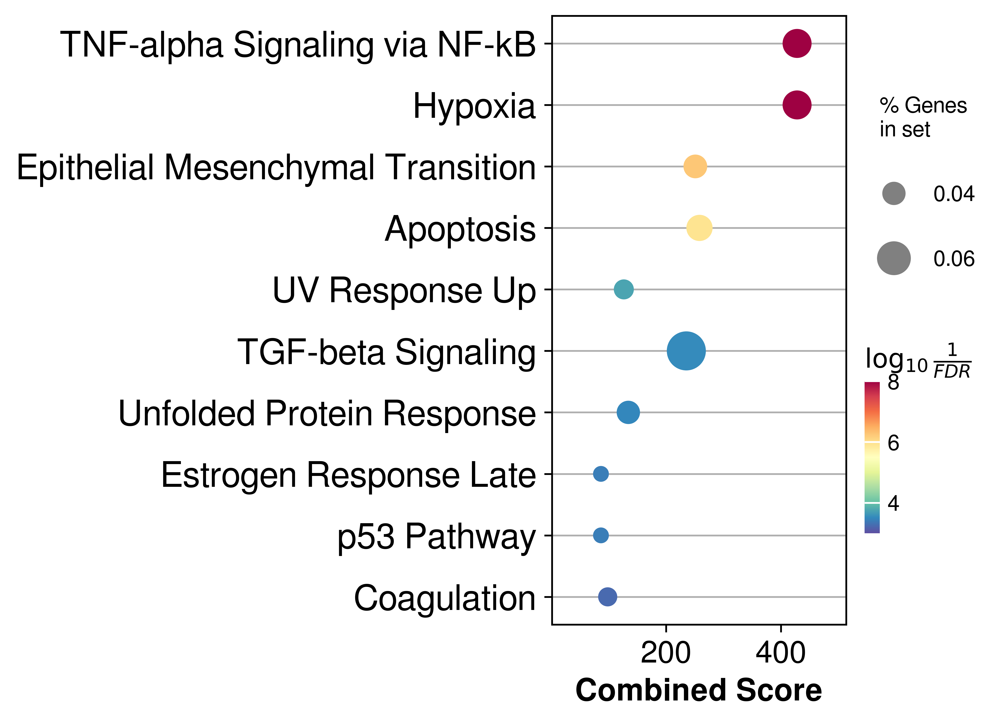

In [85]:
gene_list = shared_genes_ec & shared_genes_mural
gene_list = gene_list & shared_genes_fb
enr_up = gp.enrichr(list(gene_list),
                    gene_sets='MSigDB_Hallmark_2020',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=40)
plt.show()

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


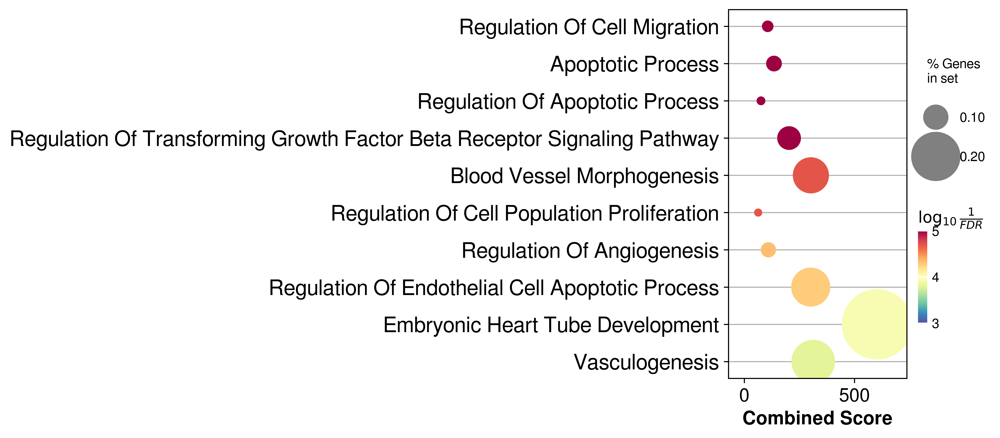

In [98]:
#gene_list = #shared_genes_fb - shared_genes_ec
gene_list = shared_genes_fb#gene_list - shared_genes_mural
enr_up = gp.enrichr(list(gene_list),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=30)
plt.show()

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


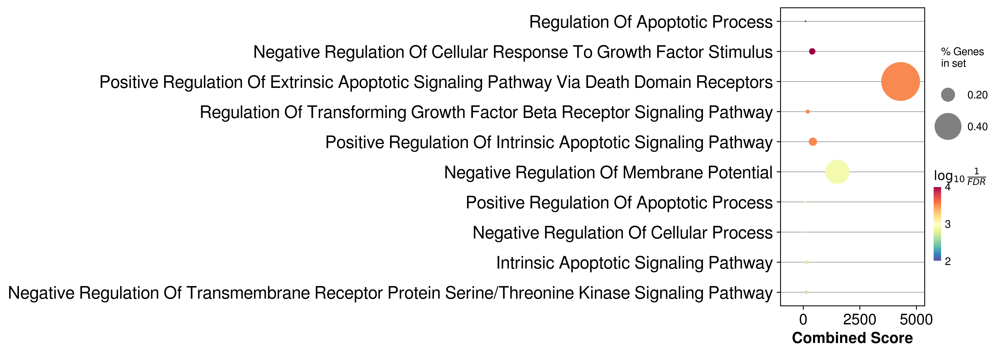

In [99]:
#gene_list = #shared_genes_fb - shared_genes_ec
gene_list = shared_genes_ec#gene_list - shared_genes_mural
enr_up = gp.enrichr(list(gene_list),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=10)
plt.show()

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


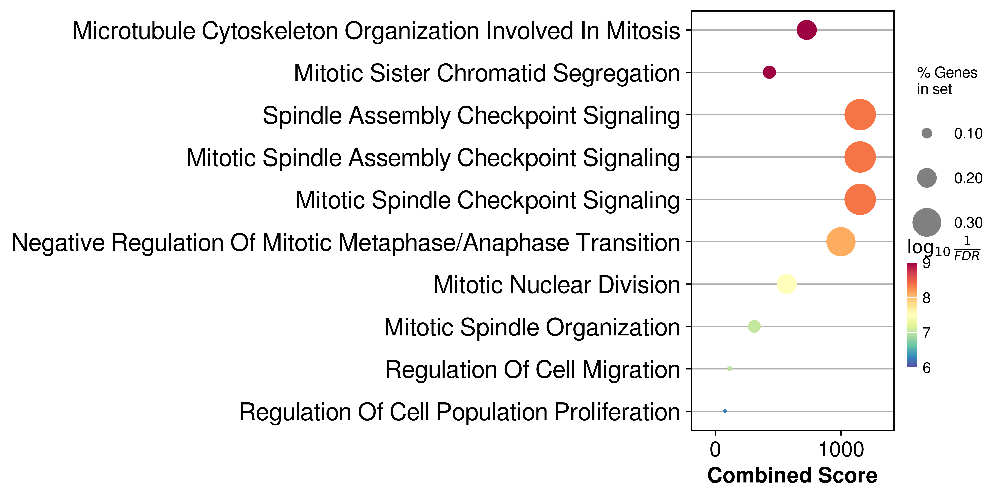

In [95]:
gene_list = shared_genes_mural#gene_list - shared_genes_mural
enr_up = gp.enrichr(list(gene_list),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=10)
plt.show()